In [7]:
from datetime import datetime
from pprint import pprint
import numpy as np
import pandas as pd

from one.api import ONE
from brainbox.io.one import SessionLoader, EphysSessionLoader
from iblatlas.atlas import AllenAtlas
from brainbox.io.one import SpikeSortingLoader

ba = AllenAtlas(res_um=10)

from brainbox.processing import bincount2D
import seaborn as sns

import matplotlib.pyplot as plt

from os.path import join

from pathlib import Path
from psychedelic_functions import paths

path_dict = paths()

import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import matplotlib.colors as mcolors

In [2]:
mode = 'local'  # sets mode for all queries (one.seach* methods)
one = ONE(mode=mode)

In [3]:
# Get administration time in seconds
df_infos = pd.read_csv('recordings.csv')
df_infos['date'] = df_infos['date'].apply(lambda x: datetime.strptime(x, '%d.%m.%Y').date())
df_infos['administration_time'] = df_infos['administration_time'].apply(lambda x: np.sum(np.array([int(val) for val in x.split(':')]) * np.array([3600, 60, 1])))


In [4]:
# Note: NotImplementedError: Searching on insertions required remote connection
pids_spikes = one.search_insertions(project='psychedelics', dataset='spikes', query_type='remote')

print(f'Psychedelics probes with spike sorting: {len(pids_spikes)}')


Psychedelics probes with spike sorting: 48


In [5]:
one.mode = 'remote'


In [12]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx

def run_PCA(pid):
    print(pid)
    # Get overall timings for stimulation protocols
    eid , probeID= one.pid2eid(pid)

    # Asserting that there were two tasks run throughout the sesison - CHECK THIS WORKS
    protocols = one.get_details(eid)['task_protocol'].split('/')
    assert len(protocols) == 2
    assert len(np.unique(protocols)) == 1

    pprint(one.list_datasets(eid))
    timings = {}
    for tid in [0 ,1]:
        eid_info = one.get_details(eid)
        subject = eid_info['subject']
        date = eid_info['date']
        intervals = one.load_dataset(eid, f'alf/task_0{tid}/_ibl_passivePeriods.intervalsTable.csv').set_index('Unnamed: 0')
        spontaneous_start = intervals.loc['start', 'spontaneousActivity']
        spontaneous_stop = intervals.loc['stop', 'spontaneousActivity']
        timings[f'spontaneous_start_0{tid}'] = spontaneous_start
        timings[f'spontaneous_stop_0{tid}'] = spontaneous_stop
        # gabors = one.load_dataset(eid, f'alf/task_0{tid}/_ibl_passiveGabor.table.csv')
        # stims = one.load_dataset(eid, f'alf/task_0{tid}/_ibl_passiveStims.table.csv')
        # task_stop = np.max([gabors['stop'].max(), stims.max().max()])
        # timings[f'task_stop_0{tid}'] = task_stop
        admin_time = df_infos[(df_infos['animal_ID'] == subject) & (df_infos['date'] == date)]['administration_time'].values[0]
        timings['admin_time'] = admin_time
    print (timings)
    # Load in spikes
    sl = SpikeSortingLoader(pid=pid, one=one, atlas=ba)
    spikes, clusters, channels = sl.load_spike_sorting()
    clusters = sl.merge_clusters(spikes, clusters, channels)

    # Only keep IBL good neurons
    spikes.times = spikes.times[np.isin(spikes.clusters, clusters.cluster_id[clusters.label == 1])]
    spikes.depths = spikes.depths[np.isin(spikes.clusters, clusters.cluster_id[clusters.label == 1])]
    spikes.clusters = spikes.clusters[np.isin(spikes.clusters, clusters.cluster_id[clusters.label == 1])]

    # Convert to mm
    spikes.depths = spikes.depths / 1000
    # Get spike raster
    iok = ~np.isnan(spikes.depths)
    R, times, depths = bincount2D(spikes.times[iok], spikes.depths[iok], xbin=0.01, ybin=0.02, weights=None)
        
    # %% Plot figure
    f, ax1 = plt.subplots(1, 1, figsize=(5, 2.5), dpi=300)
    ax1.imshow(R, aspect='auto', cmap='binary', vmin=0, vmax=np.std(R),
            extent=np.r_[times[[0, -1]], depths[[0, -1]]], origin='upper')
    ax1.set(ylim=[0, 4], ylabel='Depth (mm)')
    #ax1.set_title('Awake', color=colors['awake'], fontweight='bold')
    ax1.set(xticks=[ax1.get_xlim()[0] + 60, ax1.get_xlim()[0] + 660])
    ax1.text(ax1.get_xlim()[0] + 350, 4.3, '10 min', ha='center', va='center')
    ax1.axes.get_xaxis().set_visible(False)
    ax1.invert_yaxis()

    for i in np.arange(1, channels['acronym'].shape[0], 50):
        ax1.text(ax1.get_xlim()[-1]+50, channels['axial_um'][channels['acronym'].shape[0] - i] / 1000,
                channels['acronym'][i], fontsize=8)
    for key in timings:
        ax1.axvline(timings[key], color = "red", linewidth=0.2) # add linewidth parameter to make lines thinner
        ax1.text(timings[key], ax1.get_ylim()[0]-4, key, ha ='left', rotation = 45 ,color = "red", fontsize = 3) # adjust position and rotation of text
    plt.tight_layout()
    sns.despine(trim=True, offset=2)
    plt.savefig(join(path_dict['fig_path'], 'example_raster.pdf'))


    start_index_00 = find_nearest(times, timings['spontaneous_start_00'])
    stop_index_00 = find_nearest(times, timings['spontaneous_stop_00'])
    start_index_01 = find_nearest(times, timings['spontaneous_start_01'])
    stop_index_01 = find_nearest(times, timings['spontaneous_stop_01'])
    fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

    spontaneous_activity_00 = R[:, start_index_00:stop_index_00]
    spontaneous_activity_01 = R[:, start_index_01:stop_index_01]

    im1 = ax1.imshow(spontaneous_activity_00, 
                aspect='auto', cmap='binary', vmin=0, vmax=np.std(R), 
                extent=np.r_[times[[start_index_00, stop_index_00-1]], depths[[0, -1]]], origin='upper')
    ax1.set_title('Spontaneous Activity #1')

    im2 = ax2.imshow(spontaneous_activity_01, 
                aspect='auto', cmap='binary', vmin=0, vmax=np.std(R), 
                extent=np.r_[times[[start_index_01, stop_index_01-1]], depths[[0, -1]]], origin='upper')
    ax2.set_title('Spontaneous Activity #2')

    # display the plot
    plt.show()

    # perform PCA to get the first three components
    pca = PCA(n_components=20)
    pca_result_00 = pca.fit_transform(spontaneous_activity_00.T)  # transpose to make timestamp as row
    explained_variance_00 = pca.explained_variance_ratio_ # save the explained variance for 00

    pca_result_01 = pca.fit_transform(spontaneous_activity_01.T)  # transpose to make timestamp as row
    explained_variance_01 = pca.explained_variance_ratio_ # save the explained variance for 01

    fig = plt.figure(figsize = (16,8))


    # Create a 2x2 subplot grid
    fig, ax = plt.subplots(2, 2, figsize=(16,16))

    # create the first 3D subplot
    ax1 = fig.add_subplot(2, 2, 3, projection='3d')
    ax1.plot(pca_result_00[:,0], pca_result_00[:,1], pca_result_00[:,2], marker = 'o', alpha= 0.1)
    ax1.set_title('PCA trajectory of spontaneous activity 00 \n Pre-LSD')
    ax1.set_xlabel('PC1')
    ax1.set_ylabel('PC2')
    ax1.set_zlabel('PC3')

    # create the second 3D subplot
    ax2 = fig.add_subplot(2, 2, 4, projection='3d')
    ax2.plot(pca_result_01[:,0], pca_result_01[:,1], pca_result_01[:,2], marker = 'o', alpha= 0.1)
    ax2.set_title('PCA trajectory of spontaneous activity 01 \n Post-LSD')
    ax2.set_xlabel('PC1')
    ax2.set_ylabel('PC2')
    ax2.set_zlabel('PC3')

    # Create the first scree plot
    ax[0, 0].bar(np.arange(1,len(explained_variance_00)+1), explained_variance_00)
    ax[0, 0].set_title('Scree plot of spontaneous activity 00 \n Pre-LSD')
    ax[0, 0].set_xlabel('Principal Component')
    ax[0, 0].set_ylabel('Variance Explained (%)')

    # Create the second scree plot 
    ax[0, 1].bar(np.arange(1,len(explained_variance_01)+1), explained_variance_01)
    ax[0, 1].set_title('Scree plot of spontaneous activity 01 \n Post-LSD')
    ax[0, 1].set_xlabel('Principal Component')
    ax[0, 1].set_ylabel('Variance Explained (%)')

    plt.tight_layout()
    plt.show()
    plt.close()

7da0f609-e432-4773-9d6a-40e06a3b206a
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy'

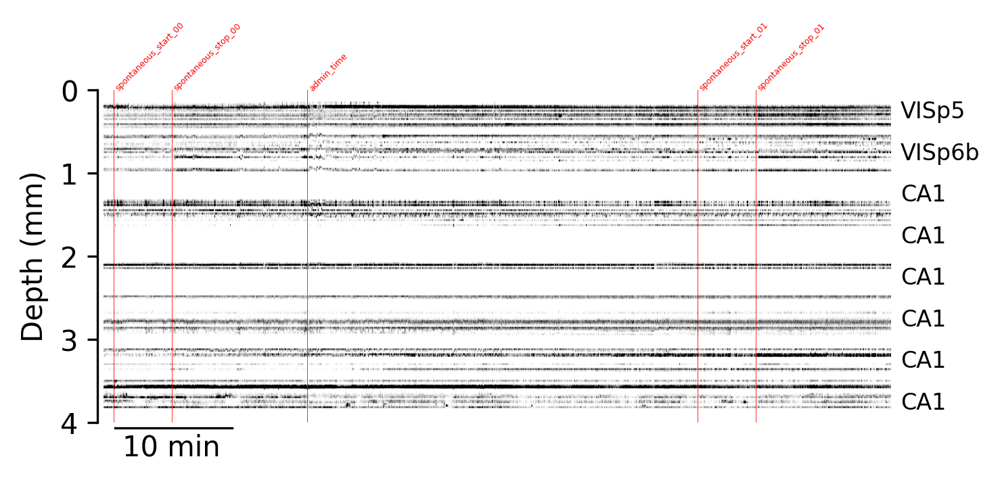

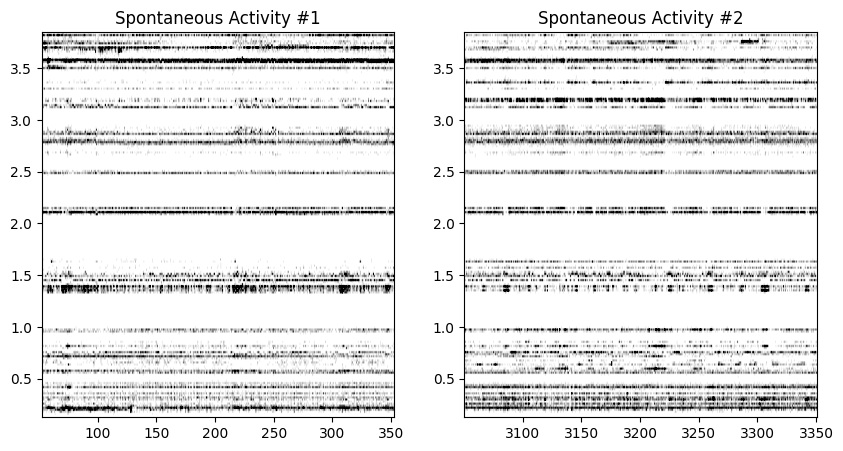

<Figure size 1600x800 with 0 Axes>

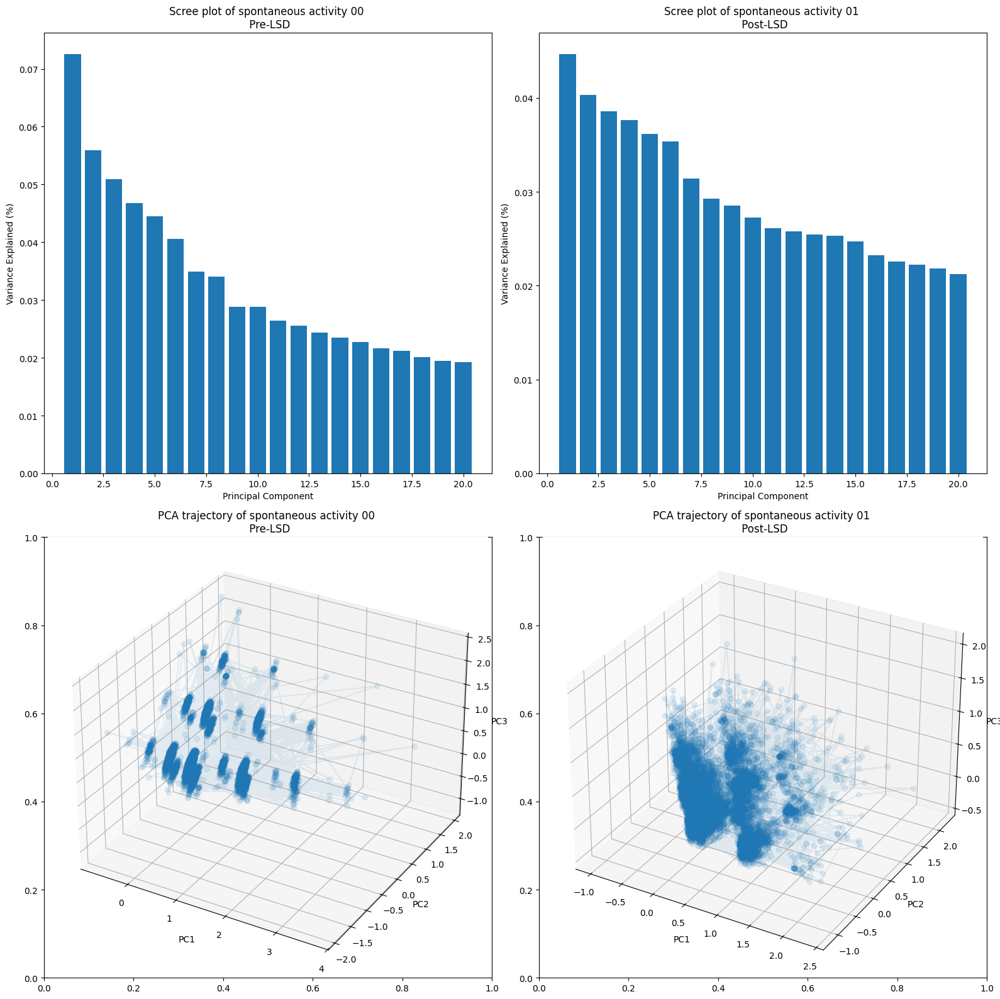

b33386fc-628d-4ffe-b6e6-81362572cf7d
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy'

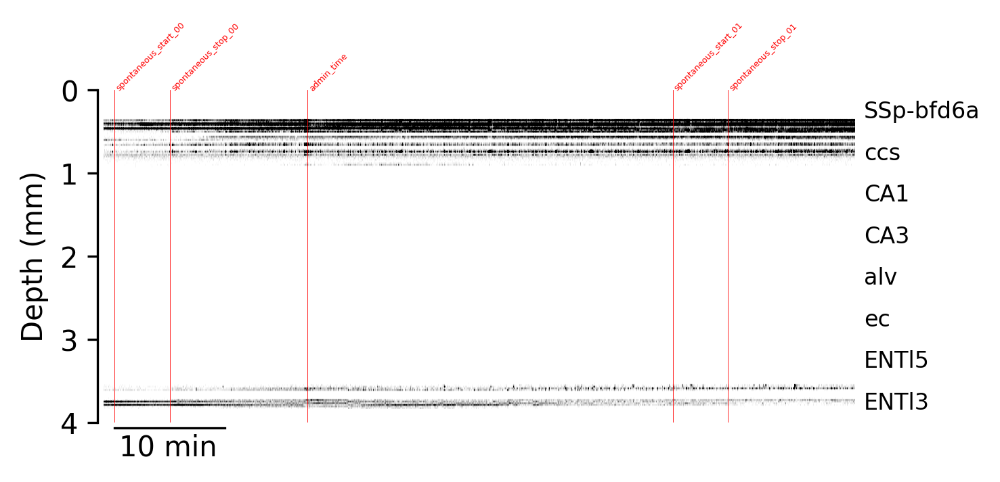

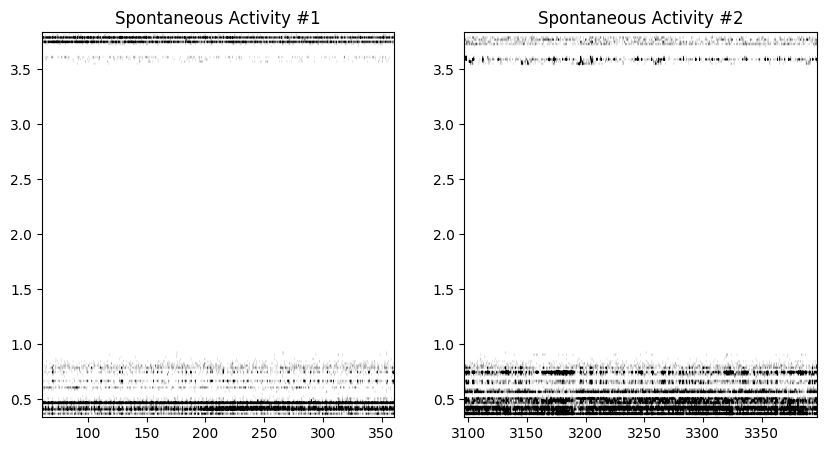

<Figure size 1600x800 with 0 Axes>

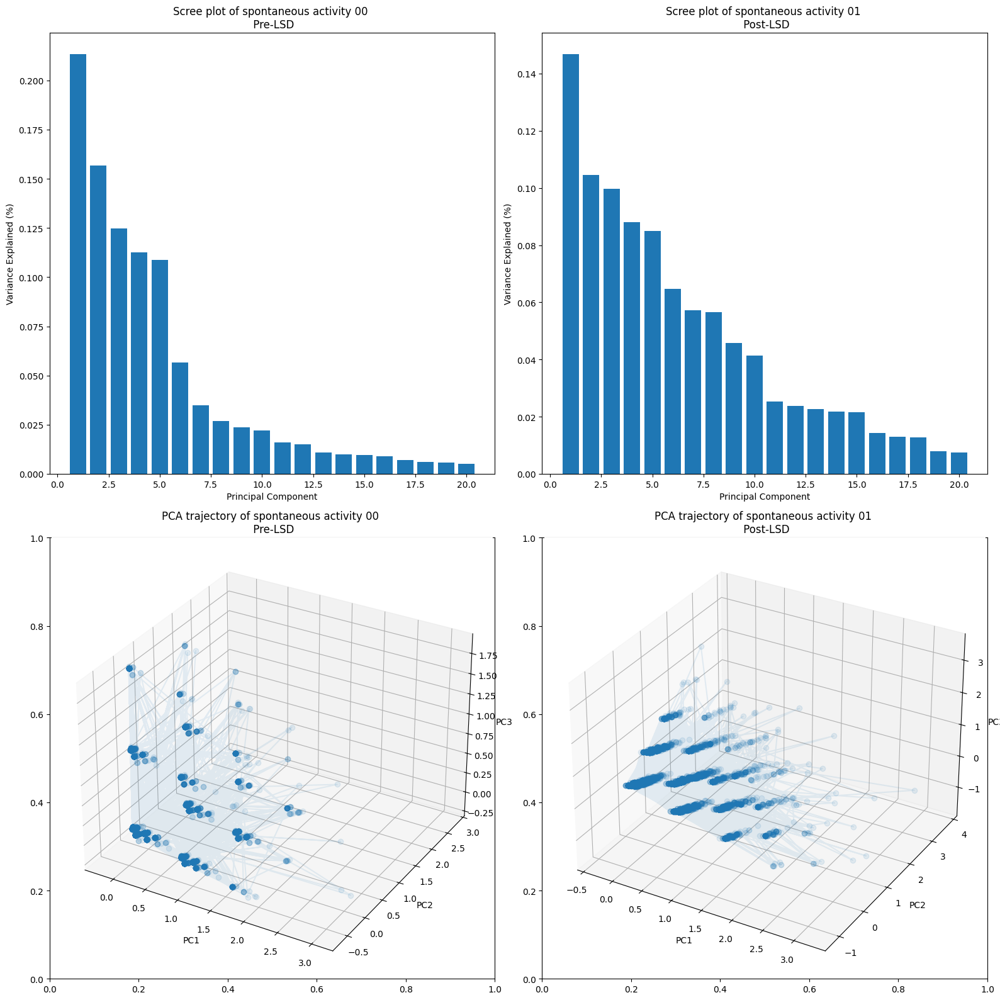

a4d69060-1834-4c71-87fe-24eec1988bce
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy'

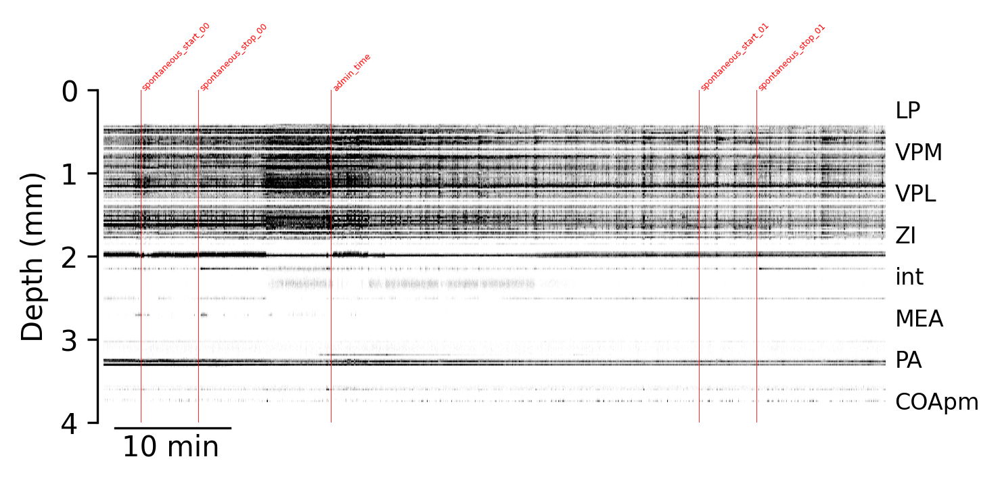

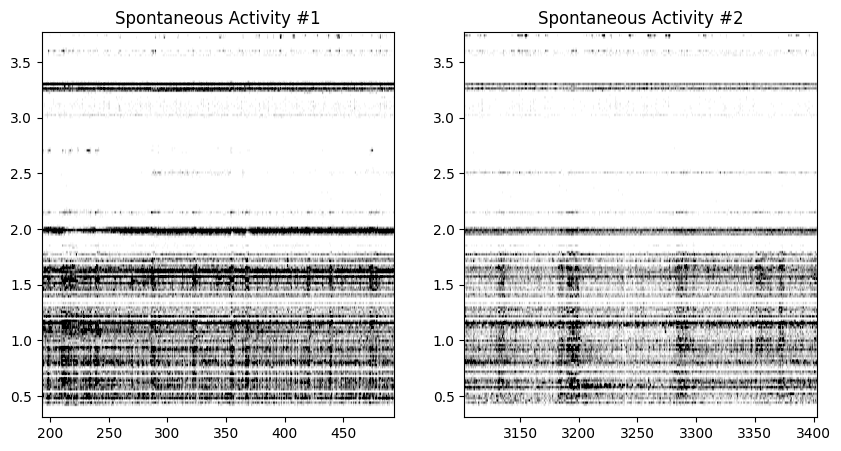

<Figure size 1600x800 with 0 Axes>

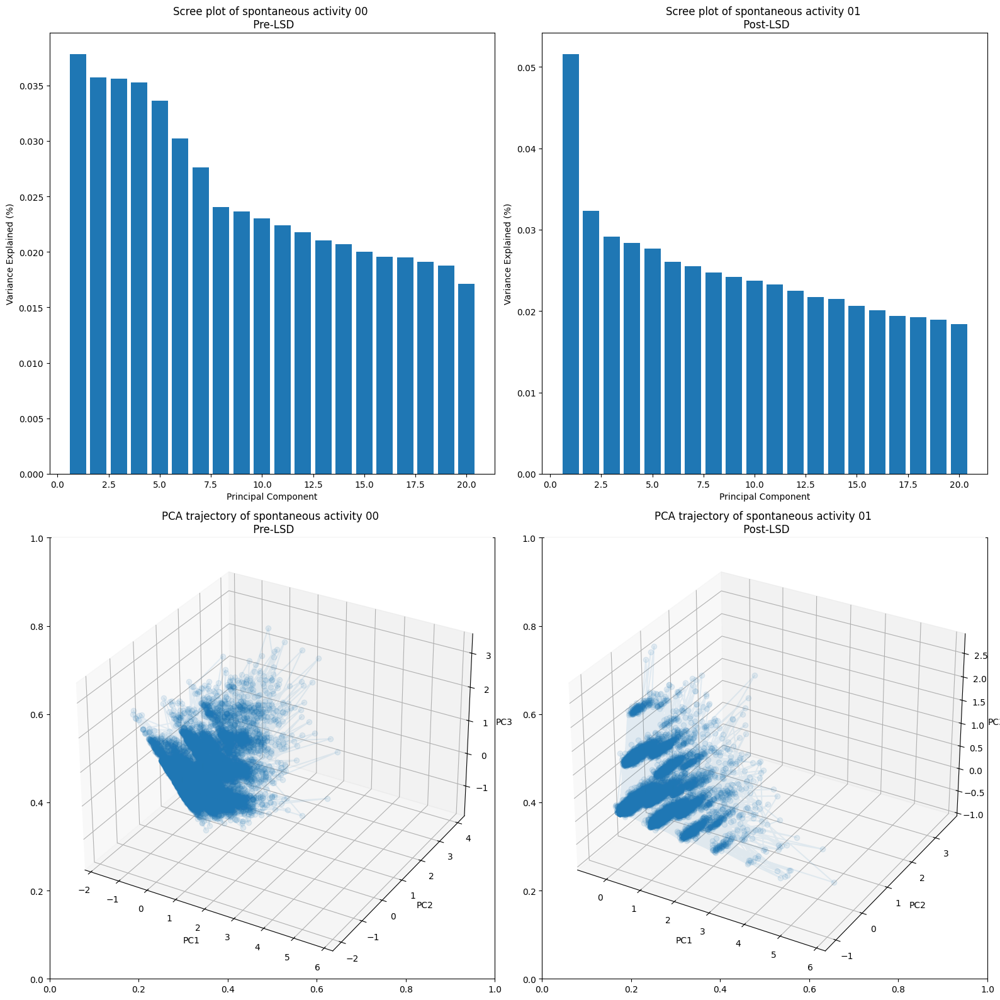

b0b6a756-8b8a-4cee-9f4f-da0daab9790d
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy'

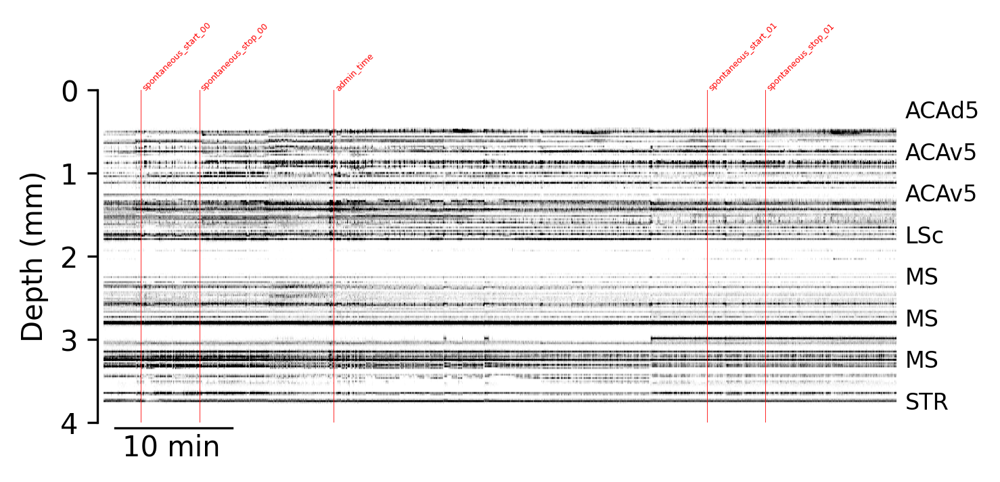

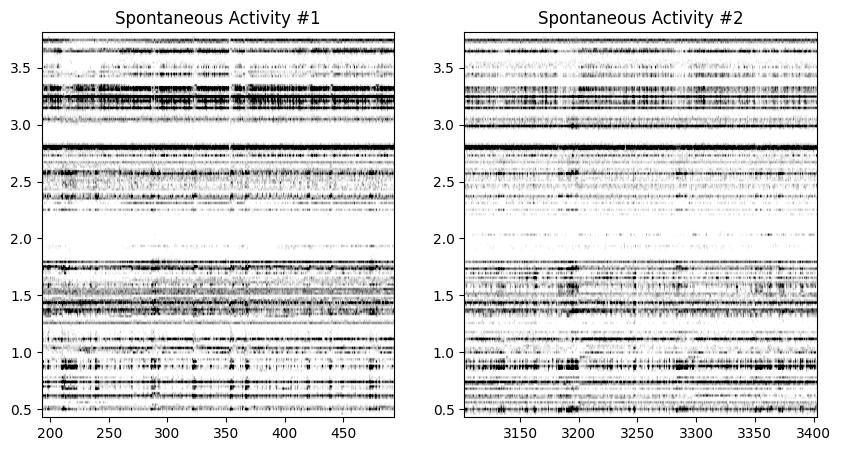

<Figure size 1600x800 with 0 Axes>

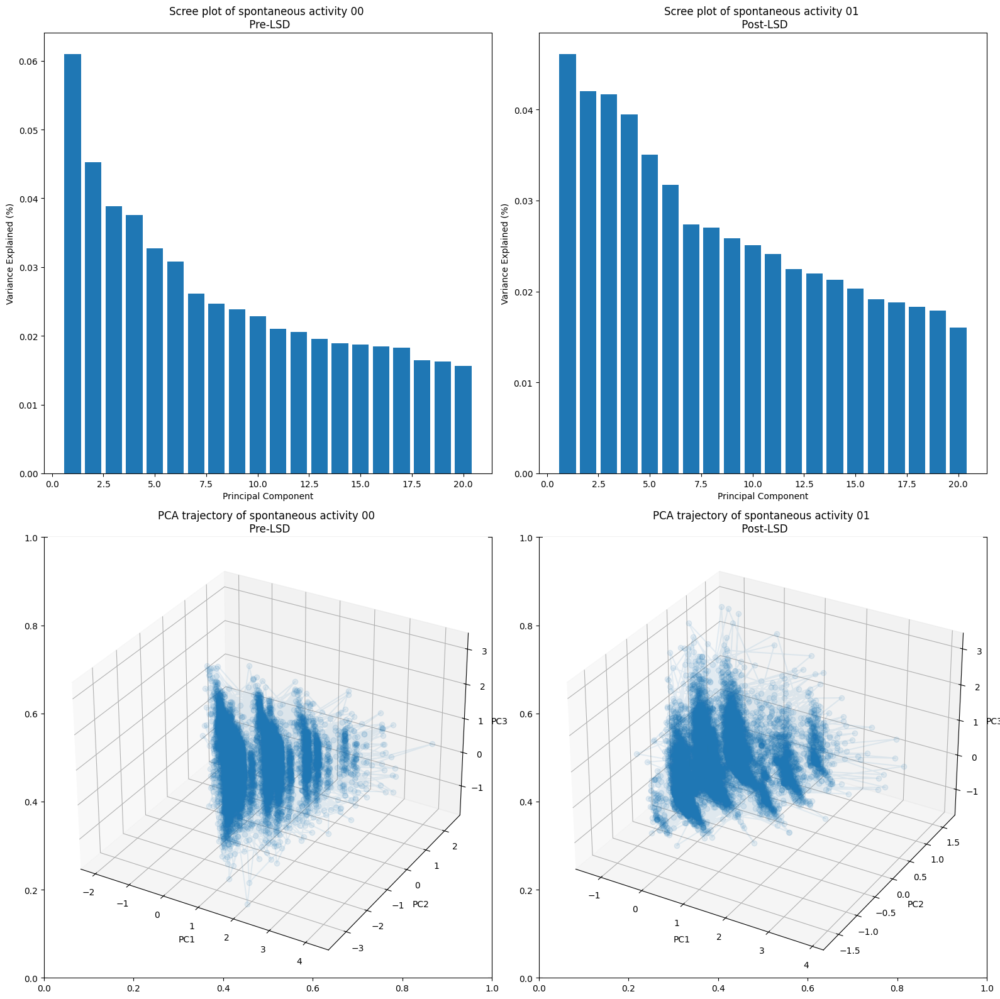

351ee92a-b405-4f34-96a8-75c44da54283
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.mlapdv.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/p

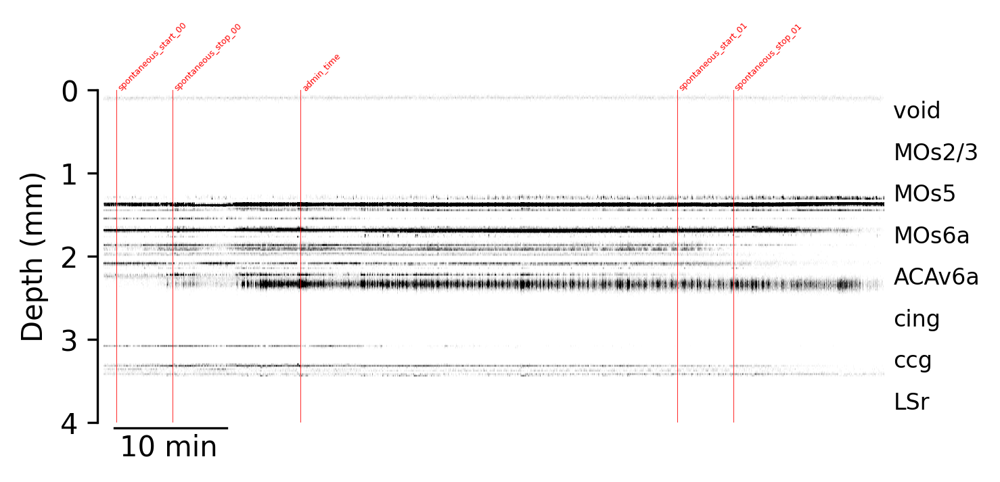

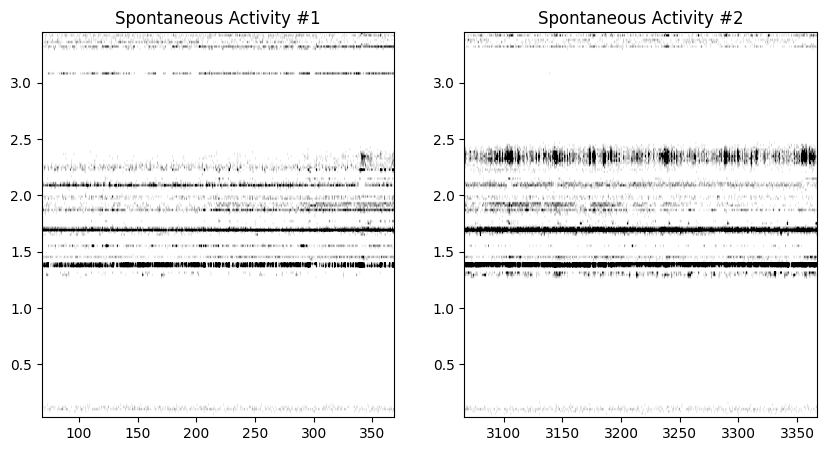

<Figure size 1600x800 with 0 Axes>

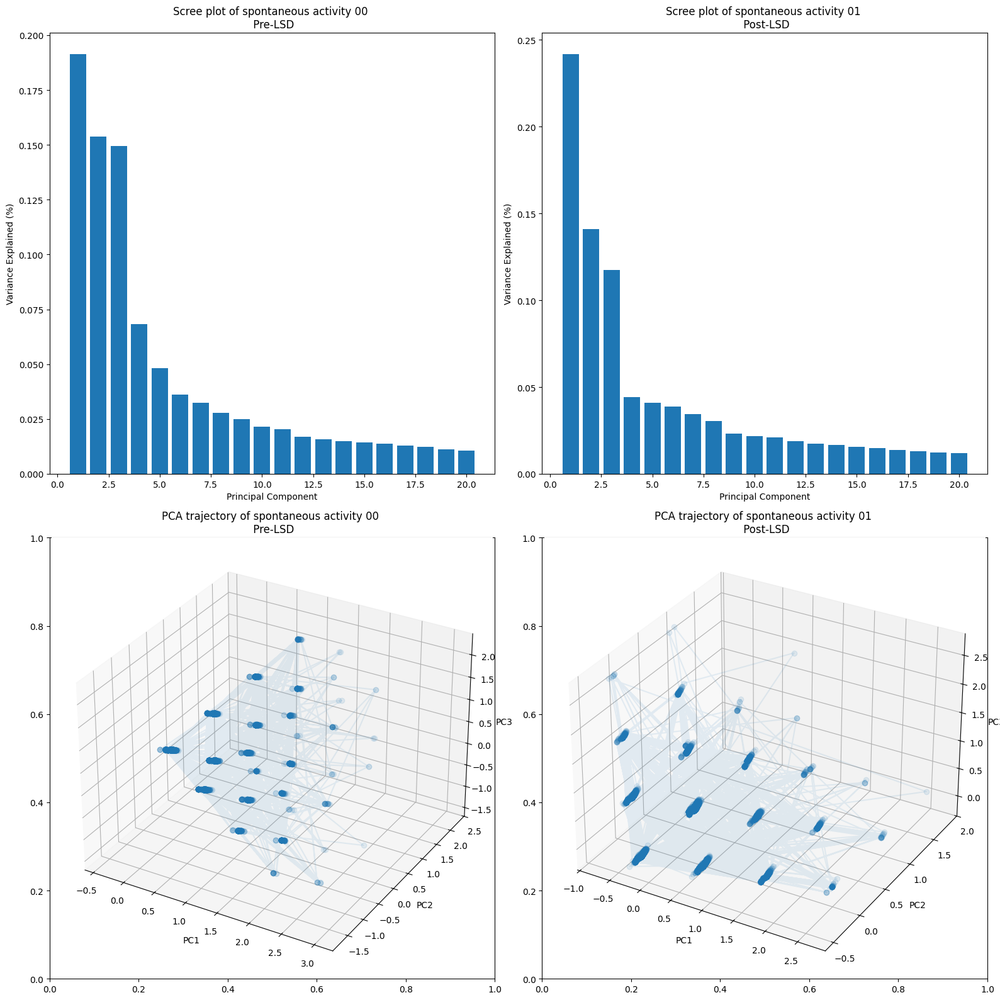

d6970b50-25b2-4621-893f-45e1fd0e8ce2
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.mlapdv.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/p

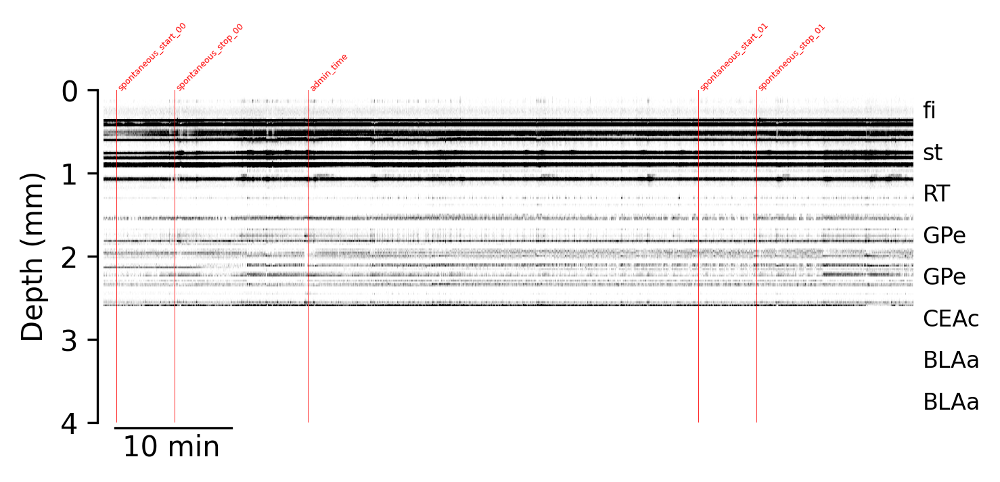

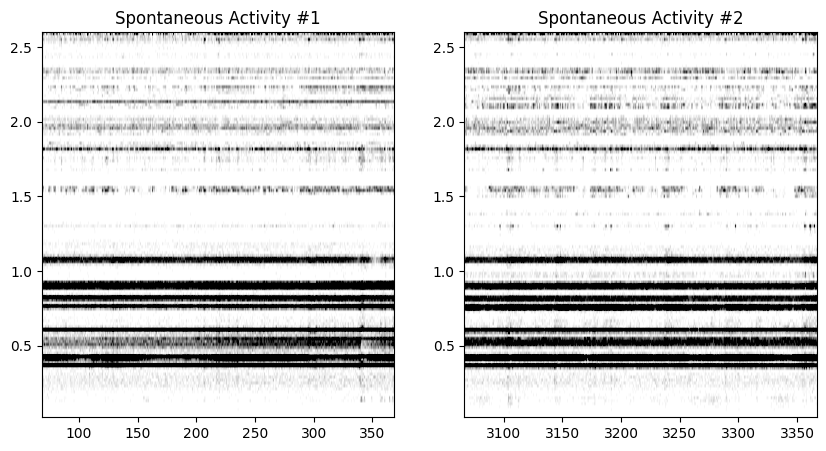

<Figure size 1600x800 with 0 Axes>

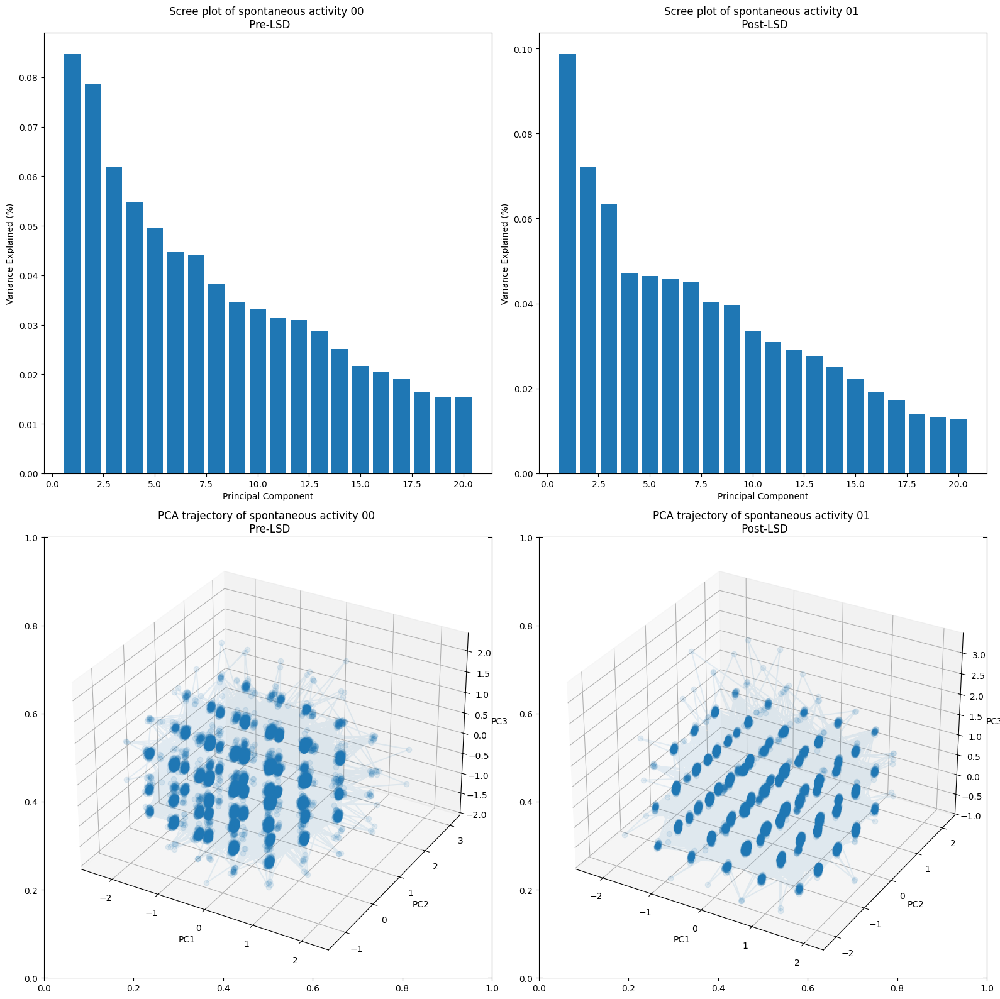

385d74d9-3ff4-4503-a831-b3dcc02ab0af
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.mlapdv.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/p

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-06048/2023-05-31/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 208/208 [00:00<00:00, 543B/s]


Unexpected error Dataset "alf/task_01/_ibl_passivePeriods.intervalsTable.csv" not found 
 The ALF object was not found.  This may occur if the object or namespace or incorrectly formatted e.g. the object "_ibl_trials.intervals.npy" would be found with the filters `object="trials", namespace="ibl"`  occurred for PID: f529221f-48d5-4870-bb0c-b1fb70d3d0bb. Continuing to next PID.
7911466c-fbae-46bb-b0f9-7d0a696a20b7
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-06187/2023-05-30/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 207/207 [00:00<00:00, 509B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-06187/2023-05-30/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 211/211 [00:00<00:00, 524B/s]


{'spontaneous_start_00': 92.48943030468168, 'spontaneous_stop_00': 392.55519371580334, 'admin_time': 1094, 'spontaneous_start_01': 2989.578825727579, 'spontaneous_stop_01': 3289.6279907987005}
2024-11-22 15:30:16 WARNING  one.py:359  Histology tracing for probe00 does not exist. No channels for probe00
Unexpected error 'acronym' occurred for PID: 7911466c-fbae-46bb-b0f9-7d0a696a20b7. Continuing to next PID.
73860622-fdff-46f9-a9e7-bff82ca19dec
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.ma

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-06047/2023-05-18/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 210/210 [00:00<00:00, 513B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-06047/2023-05-18/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 209/209 [00:00<00:00, 514B/s]


{'spontaneous_start_00': 85.65091422467485, 'spontaneous_stop_00': 385.7159443757965, 'admin_time': 1146, 'spontaneous_start_01': 3027.2830215976164, 'spontaneous_stop_01': 3327.331420078738}


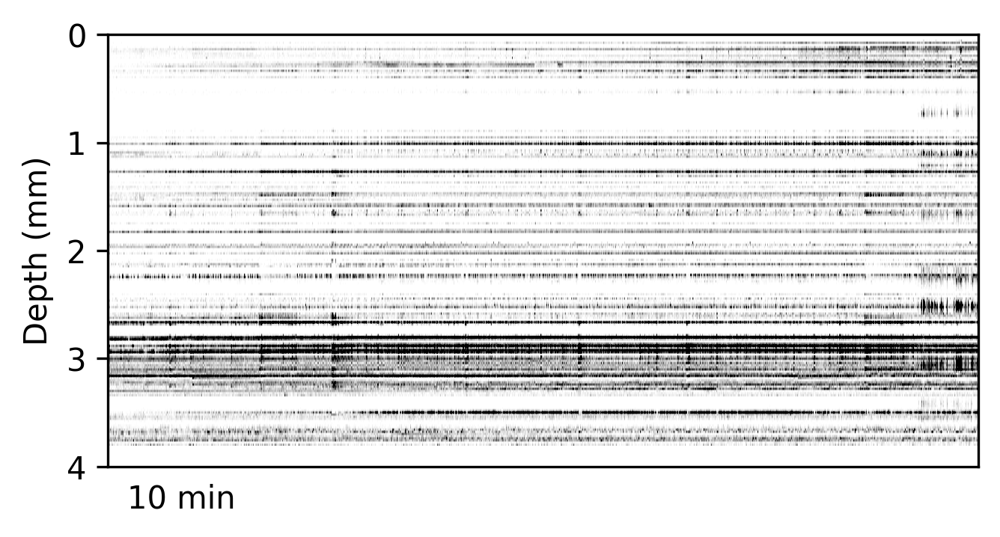

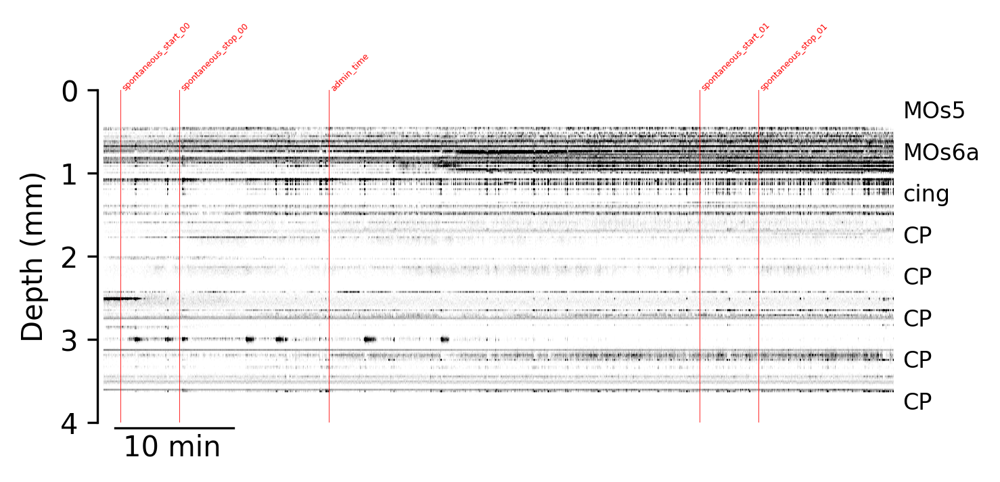

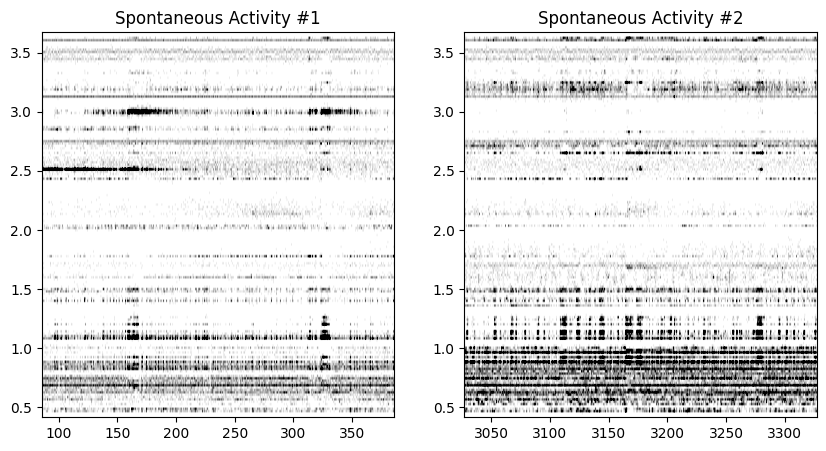

<Figure size 1600x800 with 0 Axes>

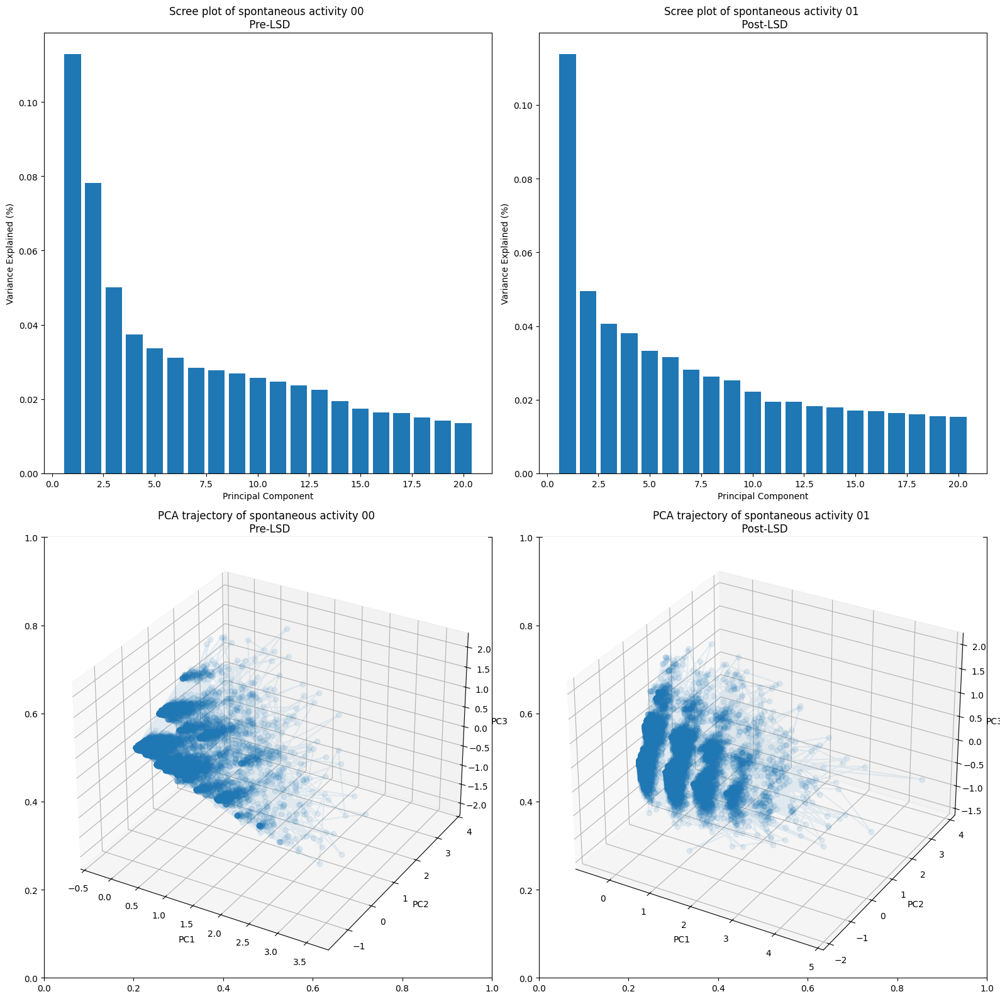

1286797b-8c9a-4541-9907-b77244d2a072
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy'

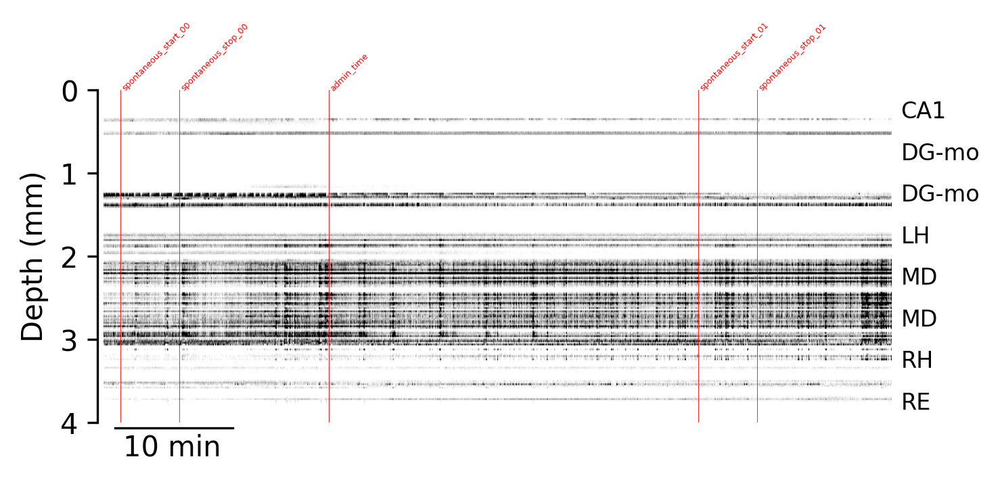

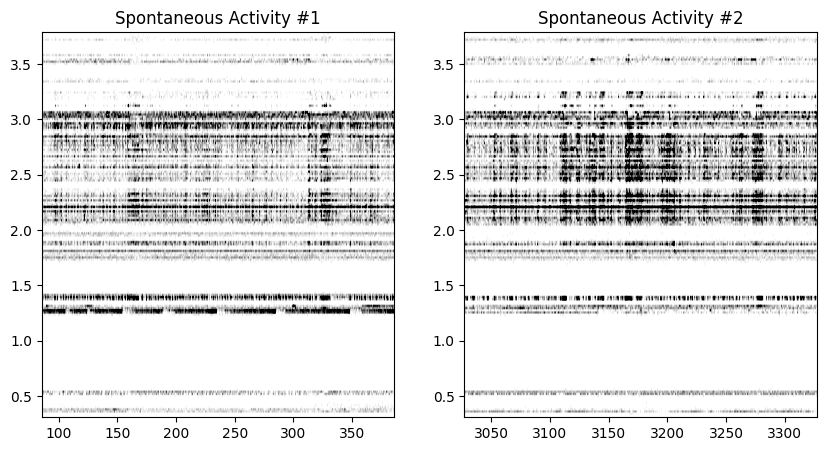

<Figure size 1600x800 with 0 Axes>

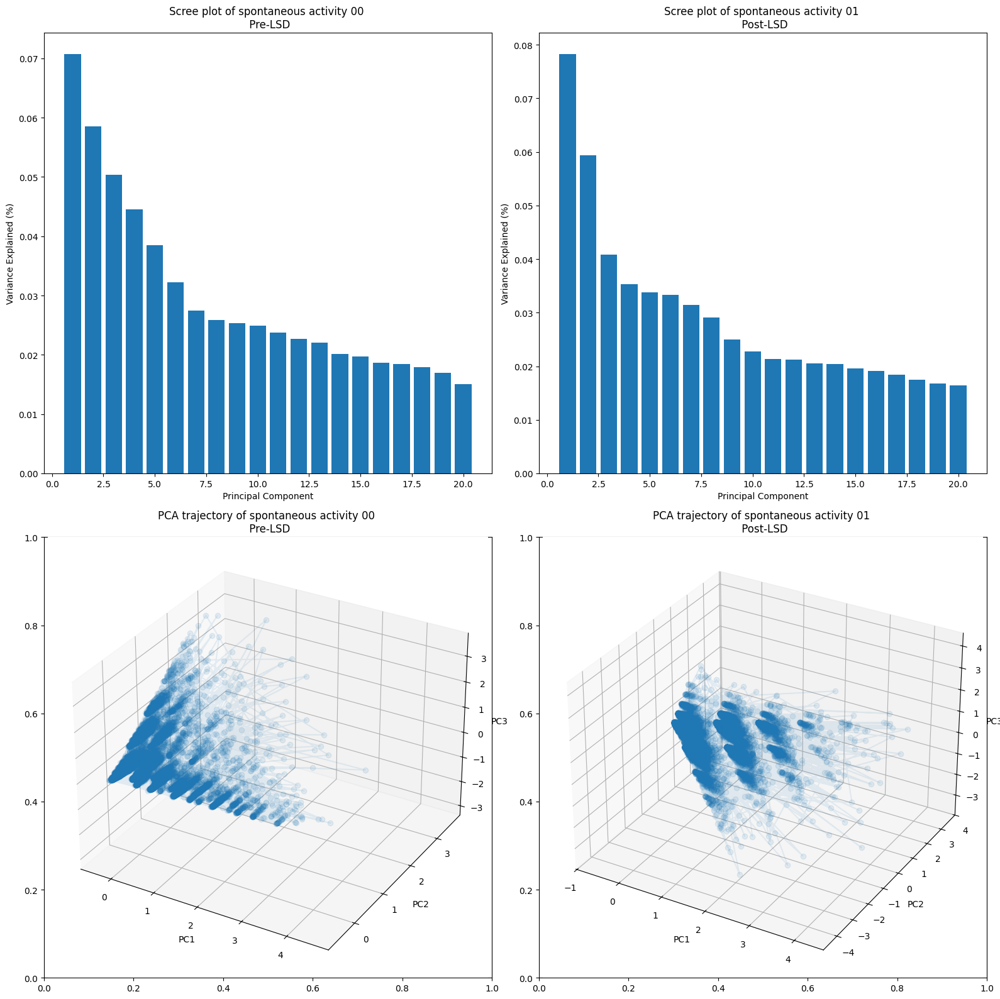

ce4407c5-0c3a-420e-9a4c-cf76e9c469cc
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.times.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.mlapdv.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/probe00/pykilosort/clusters.amps.npy',
 'alf/probe00/pykilosort/clusters.channels.npy',
 'alf/probe00/pykilosort/clusters.depths.npy',
 'alf/probe00/pykilo

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-06187/2023-05-16/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 209/209 [00:00<00:00, 513B/s]


Unexpected error Dataset "alf/task_01/_ibl_passivePeriods.intervalsTable.csv" not found 
 The ALF object was not found.  This may occur if the object or namespace or incorrectly formatted e.g. the object "_ibl_trials.intervals.npy" would be found with the filters `object="trials", namespace="ibl"`  occurred for PID: a5c59236-fd09-4f78-a57c-fab351b3959b. Continuing to next PID.
cc60f7b8-93ac-4c16-98a0-811536002bbb
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_l

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/SQL-15020/2023-04-04/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 205/205 [00:00<00:00, 607B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/SQL-15020/2023-04-04/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 213/213 [00:00<00:00, 414B/s]


{'spontaneous_start_00': 74.62278381466383, 'spontaneous_stop_00': 374.6885805557855, 'admin_time': 1073, 'spontaneous_start_01': 3070.65545058766, 'spontaneous_stop_01': 3370.704449008781}


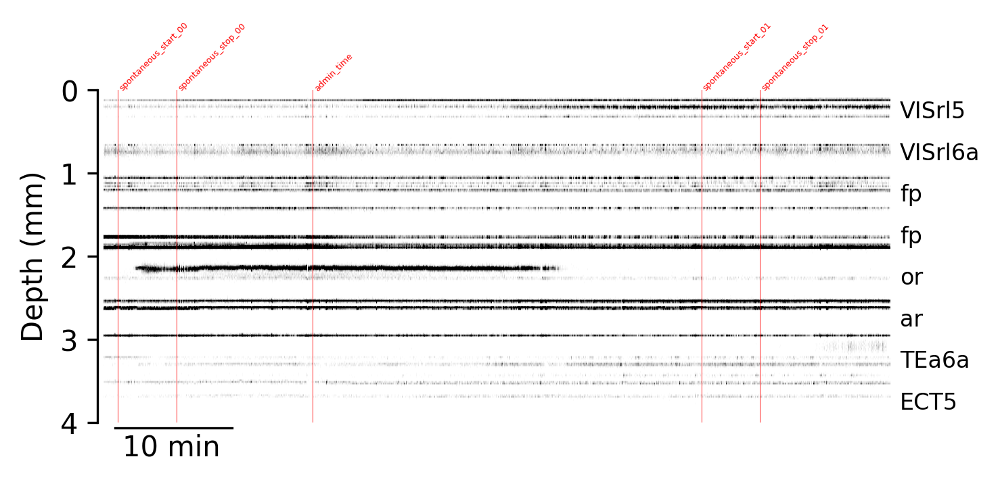

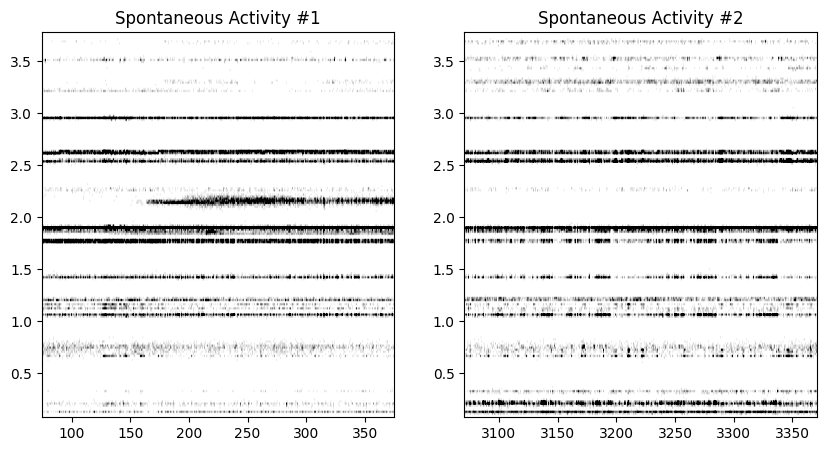

<Figure size 1600x800 with 0 Axes>

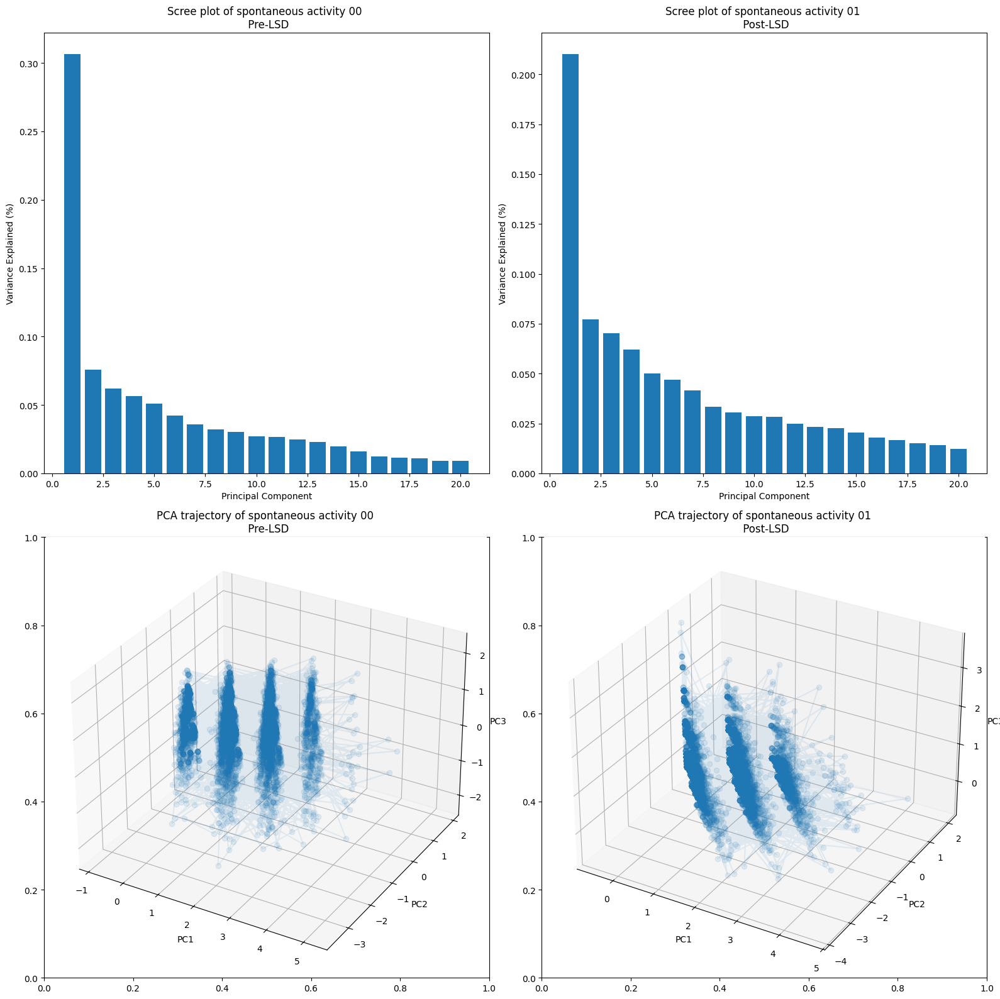

0d8aef21-2ac3-4b30-9b9c-0e1627136b9e
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykiloso

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/SQL-15020/2023-03-28/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 209/209 [00:00<00:00, 501B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/SQL-15020/2023-03-28/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 212/212 [00:00<00:00, 502B/s]


{'spontaneous_start_00': 52.62838347464183, 'spontaneous_stop_00': 352.6935136157635, 'admin_time': 1065, 'spontaneous_start_01': 2915.5488294675047, 'spontaneous_stop_01': 3215.5973945986266}


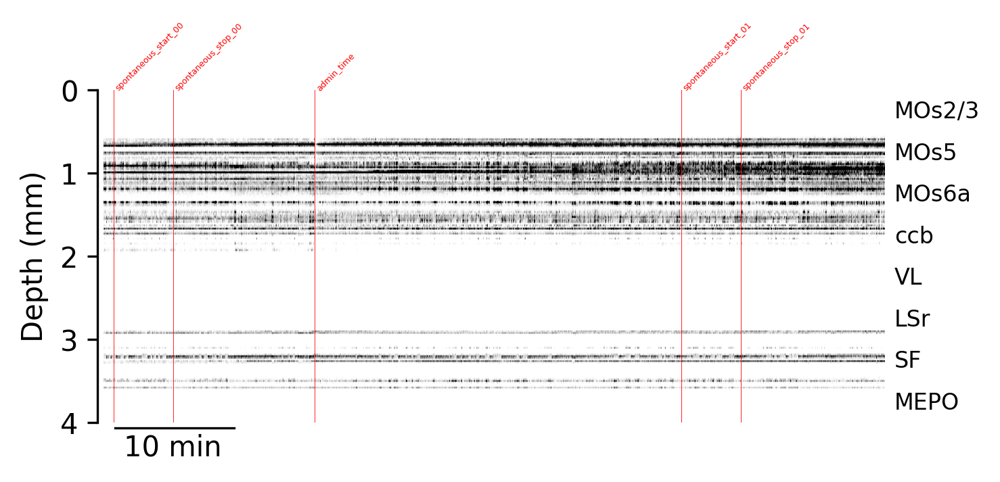

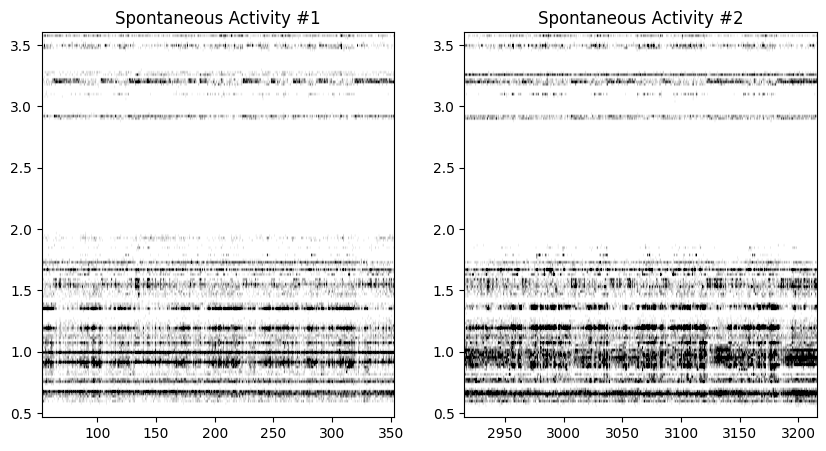

<Figure size 1600x800 with 0 Axes>

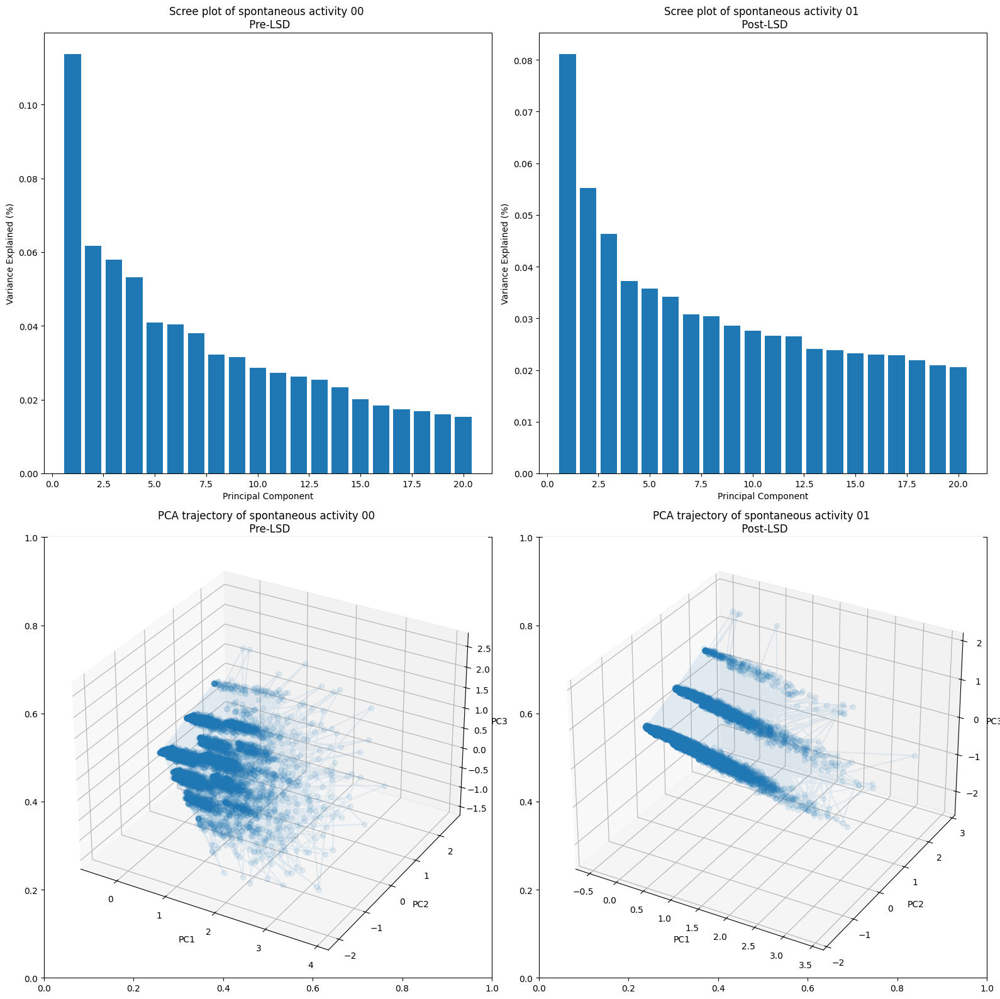

61d2d753-9f7c-4b10-8d57-29d8735c23e9
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykiloso

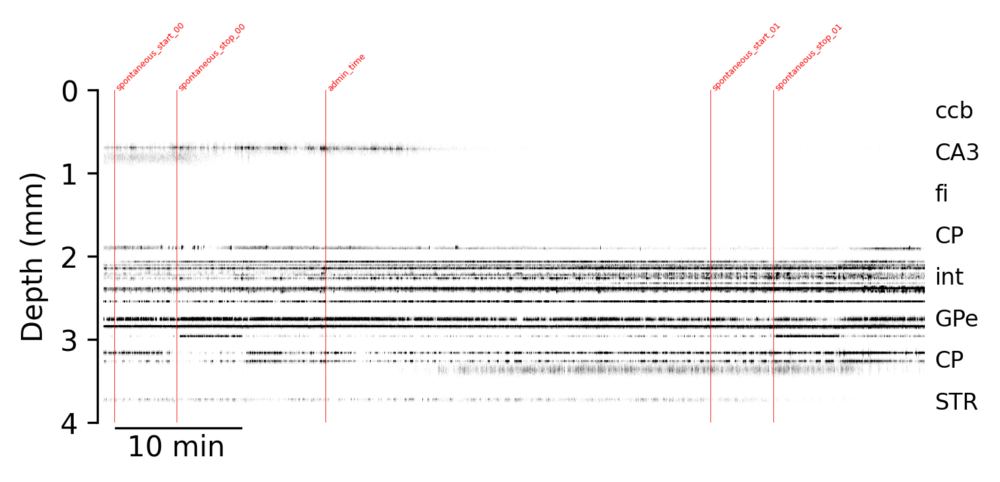

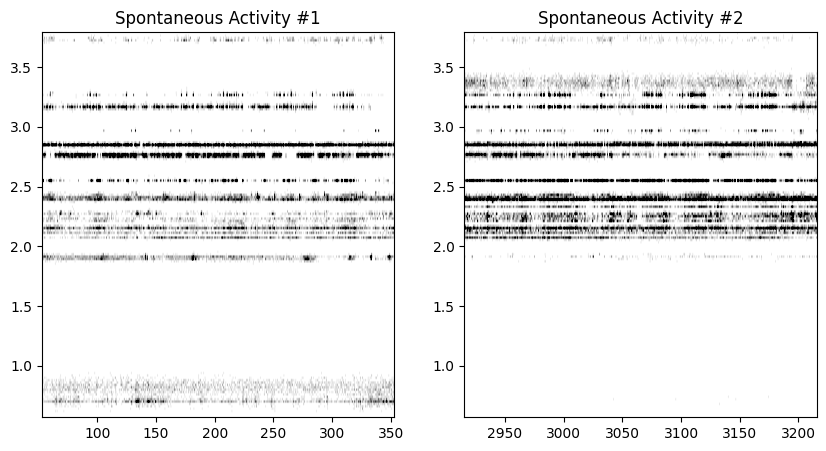

<Figure size 1600x800 with 0 Axes>

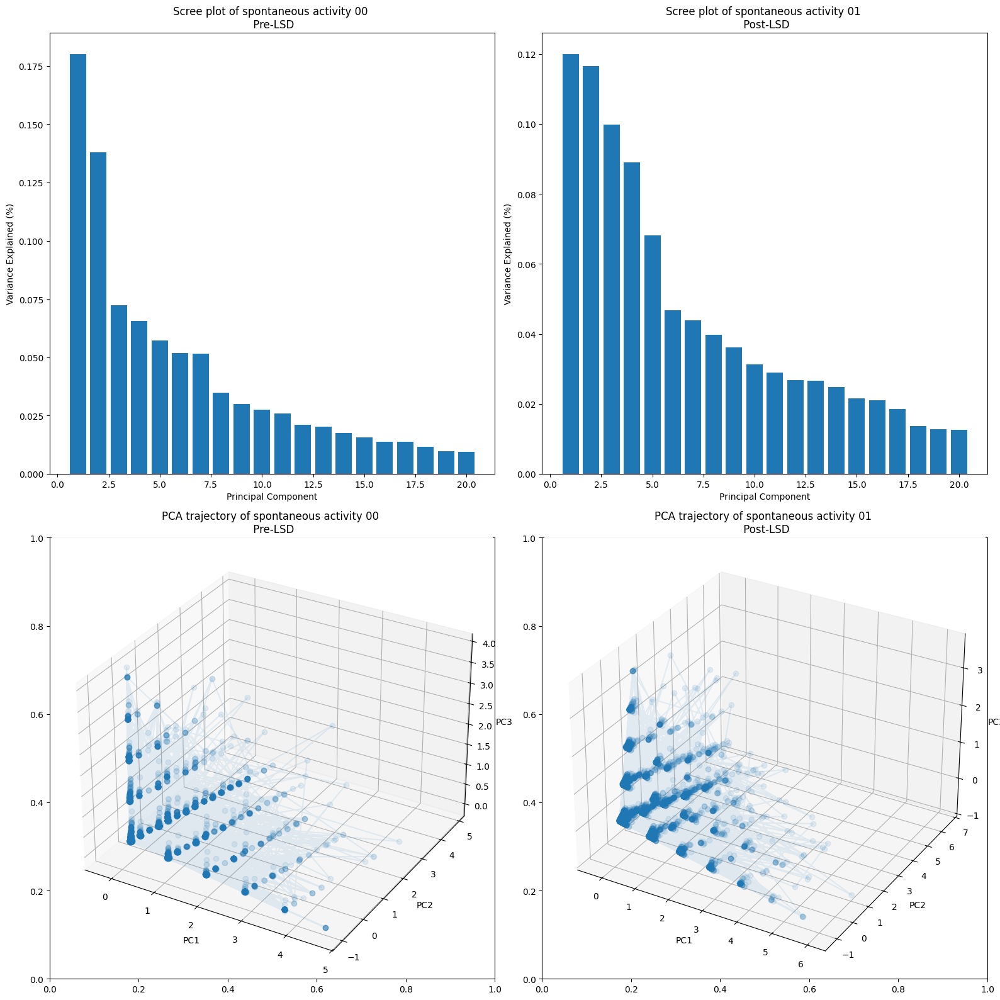

1bba4c70-64a5-440e-9d7e-7dba83b95454
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykiloso

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05989/2023-03-22/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 209/209 [00:00<00:00, 517B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05989/2023-03-22/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 212/212 [00:00<00:00, 512B/s]


{'spontaneous_start_00': 68.43423606465764, 'spontaneous_stop_00': 368.4667361357793, 'admin_time': 1121, 'spontaneous_start_01': 3007.453604737597, 'spontaneous_stop_01': 3307.5022031987182}


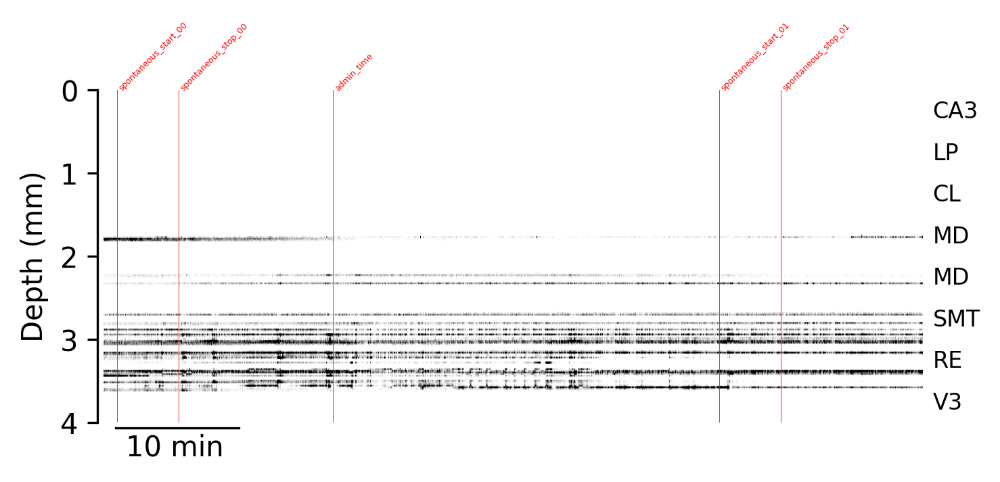

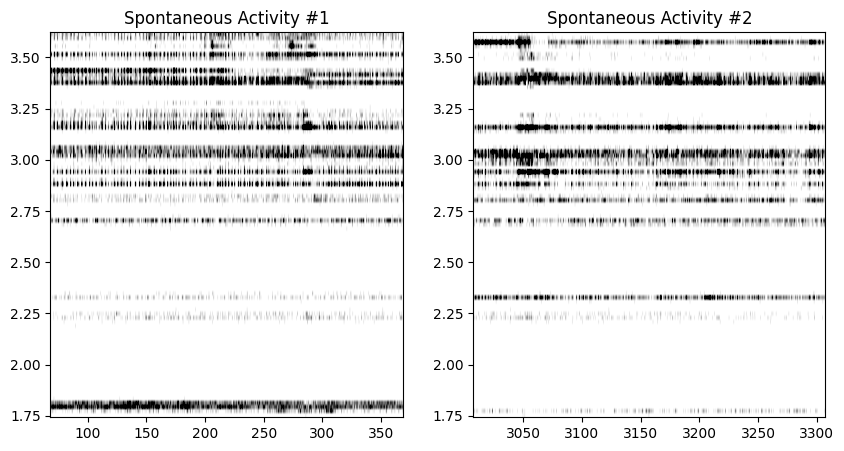

<Figure size 1600x800 with 0 Axes>

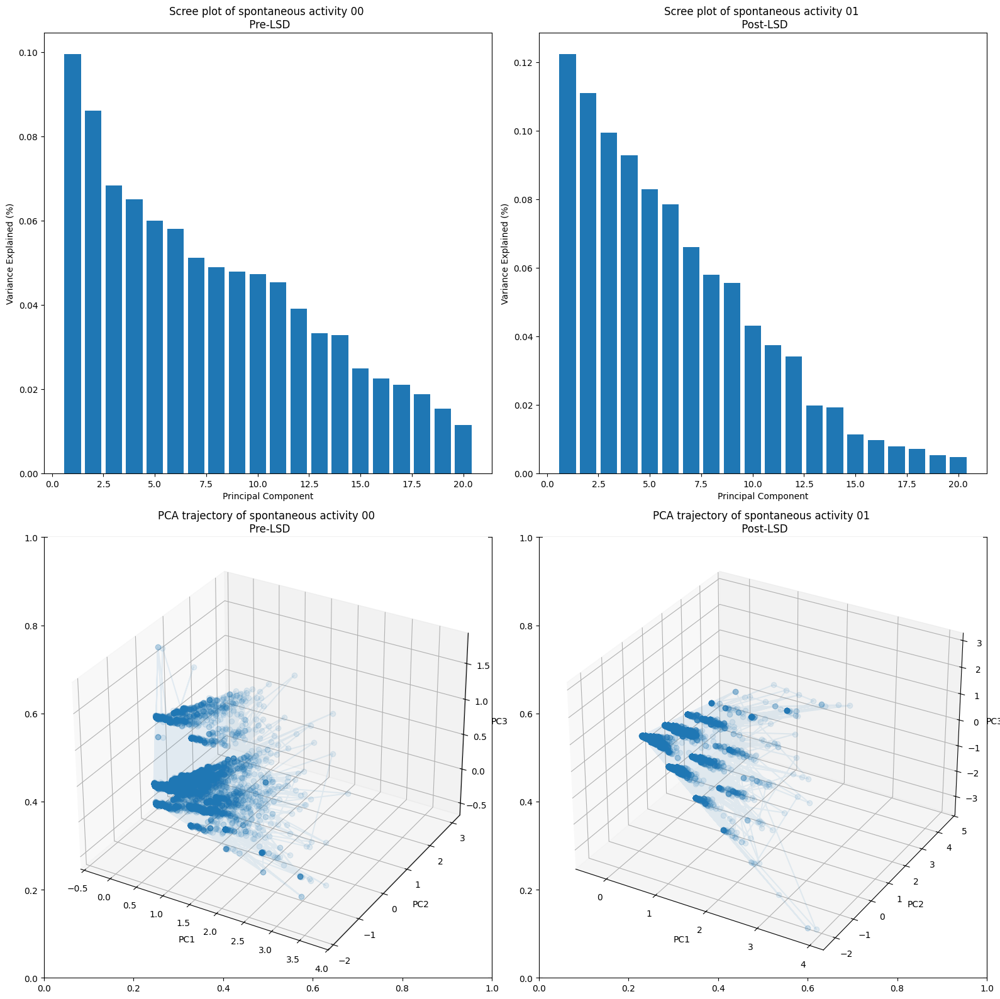

b29e04b6-b1e0-4318-8a97-5f80aa0ad6f7
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykiloso

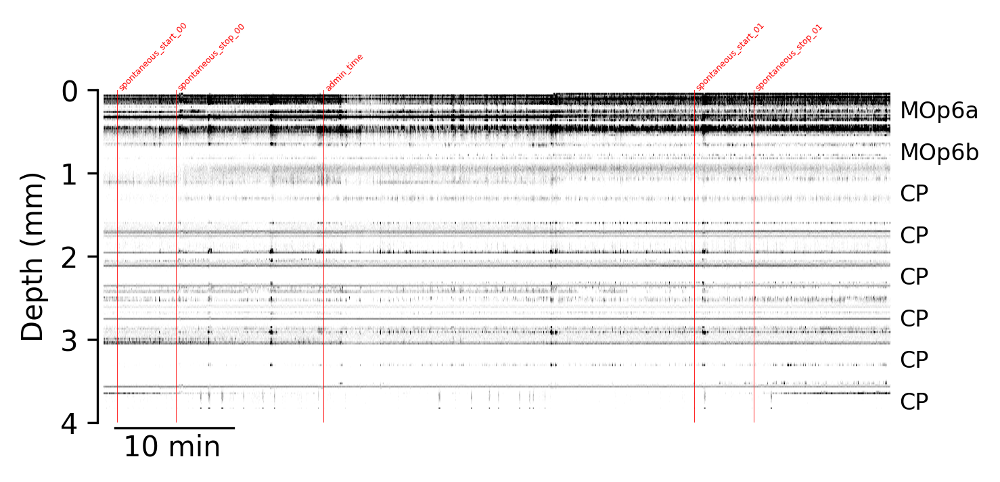

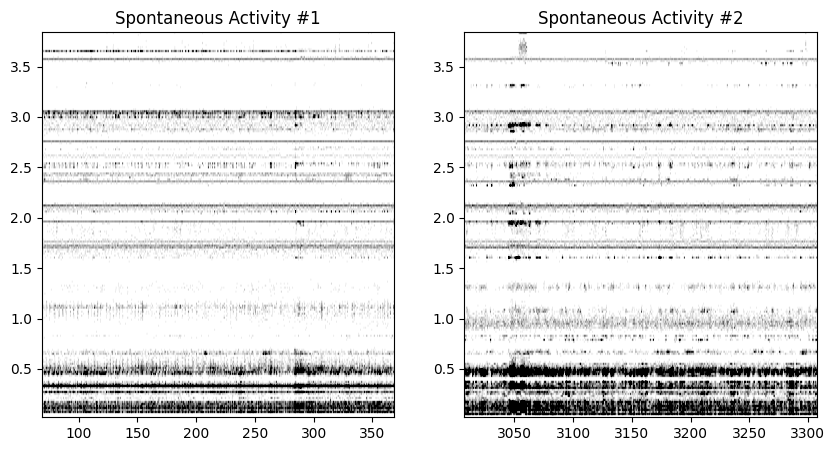

<Figure size 1600x800 with 0 Axes>

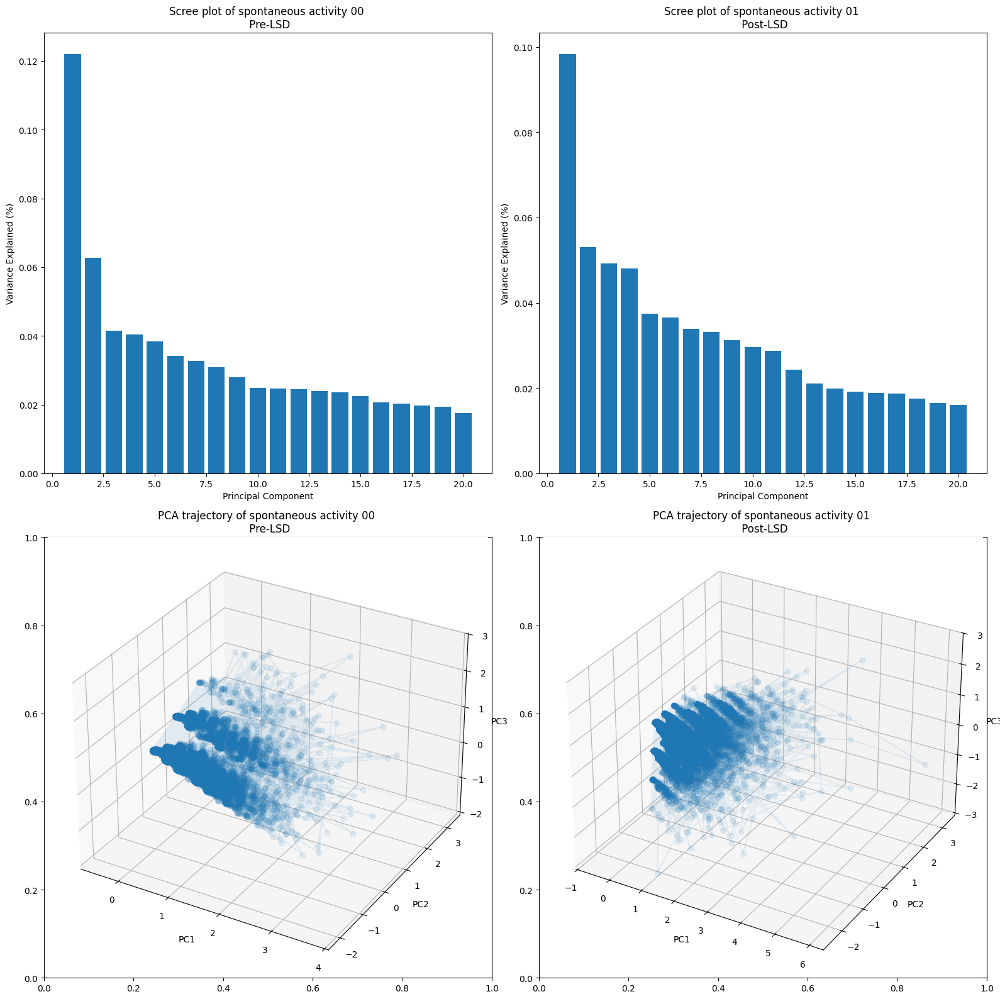

3120f1bd-ed5f-4877-bdc4-3449d5869d77
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe01/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe01/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe01/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe01/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe01/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe01/pykilosort/channels.localCoordinates.npy',
 'alf/probe01/pykilosort/channels.rawInd.npy',
 'alf/probe01/pykilosort/clusters.amps.npy',
 'alf/probe01/pykilosort/clu

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/SQL-15020/2023-03-21/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 211/211 [00:00<00:00, 509B/s]


Unexpected error Dataset "alf/task_01/_ibl_passivePeriods.intervalsTable.csv" not found 
 The ALF object was not found.  This may occur if the object or namespace or incorrectly formatted e.g. the object "_ibl_trials.intervals.npy" would be found with the filters `object="trials", namespace="ibl"`  occurred for PID: 3120f1bd-ed5f-4877-bdc4-3449d5869d77. Continuing to next PID.
820f939d-971c-4521-8424-1ed0922c5a20
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilos

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05727/2023-02-08/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 210/210 [00:00<00:00, 698B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05727/2023-02-08/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 213/213 [00:00<00:00, 517B/s]


{'spontaneous_start_00': 50.254854184639456, 'spontaneous_stop_00': 350.3036526257611, 'admin_time': 1065, 'spontaneous_start_01': 2932.1578683975213, 'spontaneous_stop_01': 3232.223231848643}
2024-11-22 15:49:45 WARNING  one.py:359  Histology tracing for probe00 does not exist. No channels for probe00
Unexpected error 'acronym' occurred for PID: 820f939d-971c-4521-8424-1ed0922c5a20. Continuing to next PID.
9d0062d1-edf7-42c2-94ab-4b14f67742e7
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',


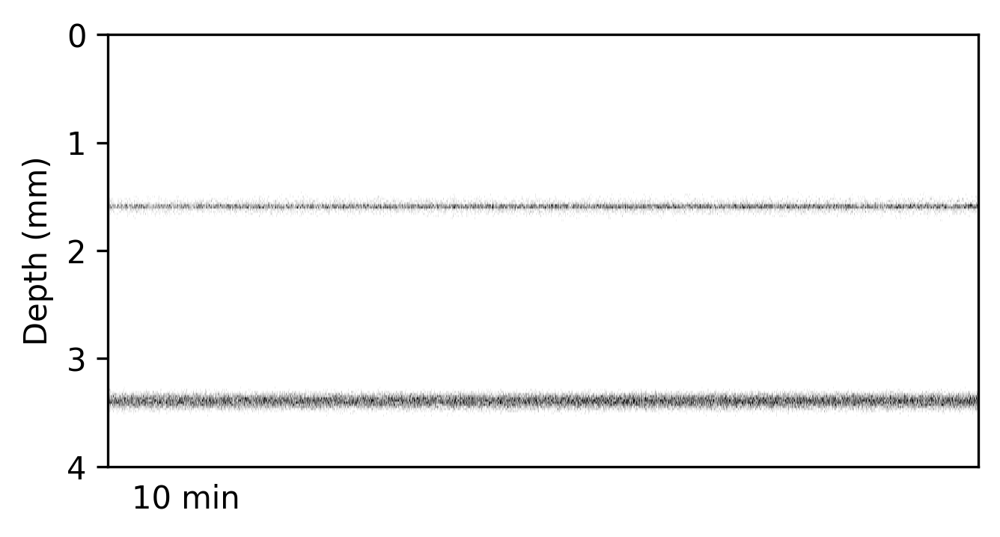

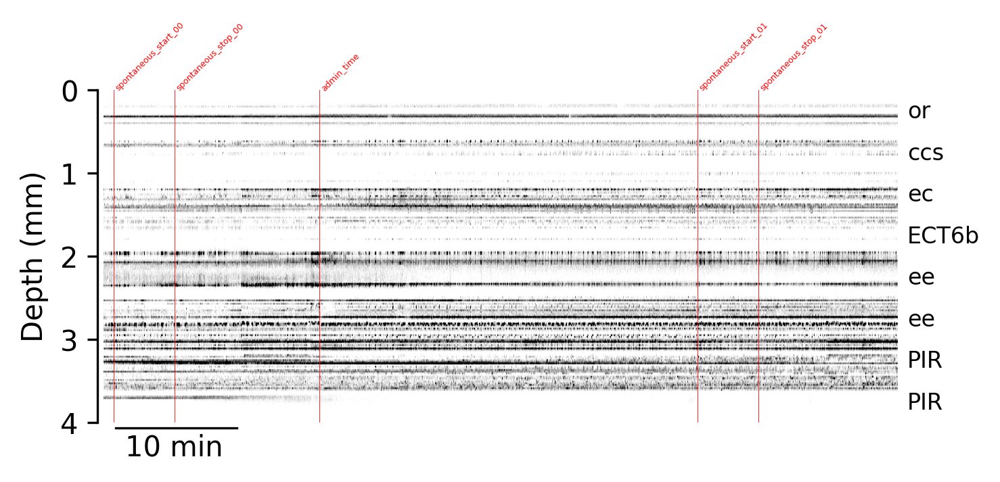

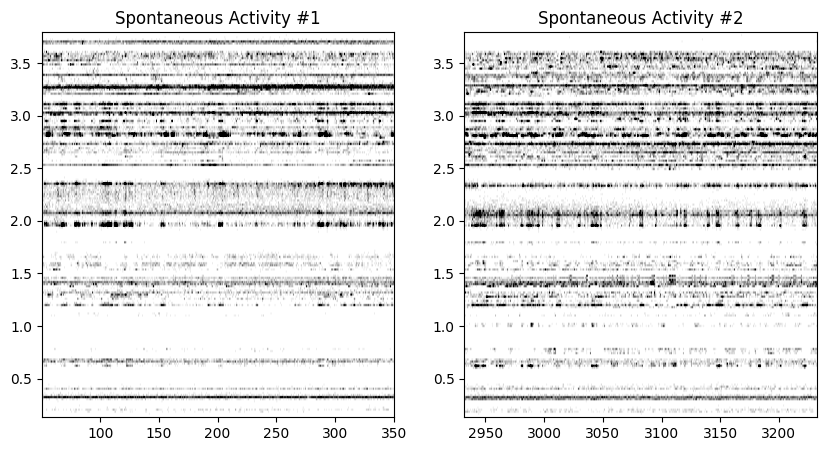

<Figure size 1600x800 with 0 Axes>

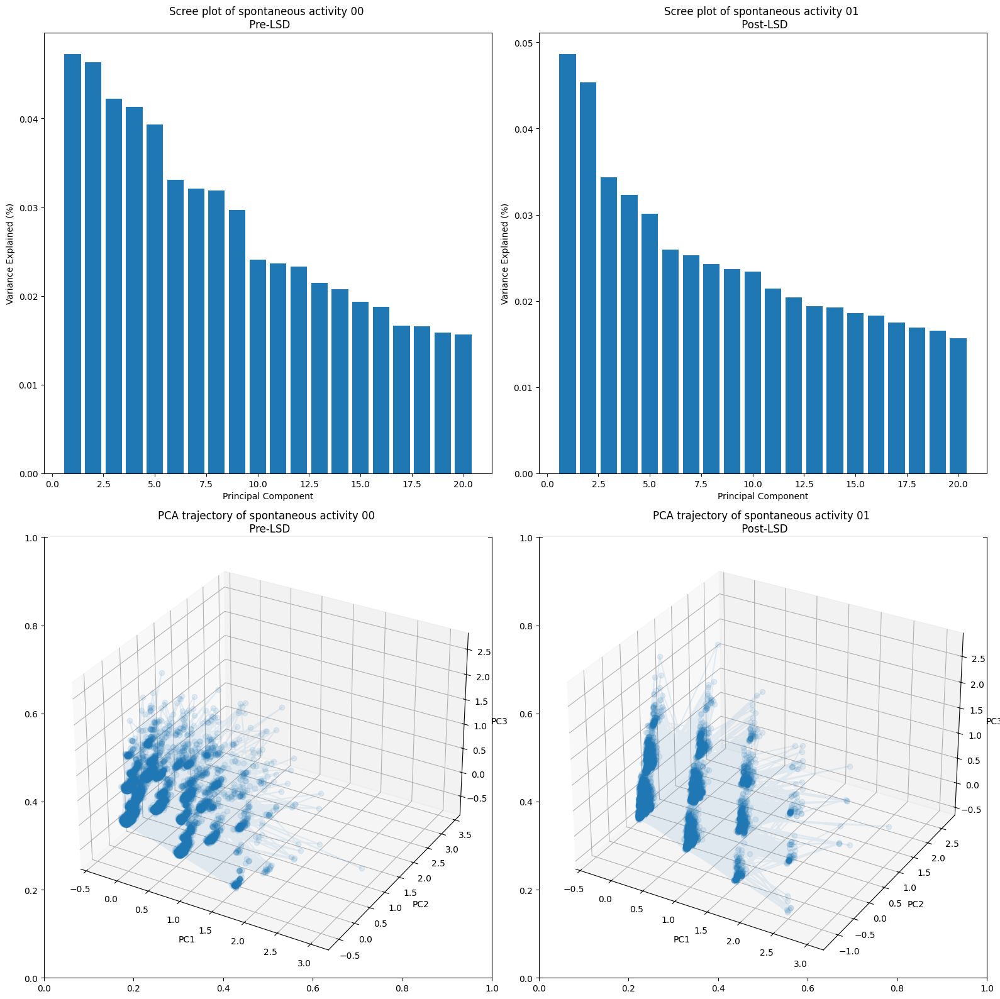

4eaaff3b-9706-440e-af3f-11d7e64f353c
Unexpected error  occurred for PID: 4eaaff3b-9706-440e-af3f-11d7e64f353c. Continuing to next PID.
c350c3c3-a493-4d7c-9826-68af6578298c
Unexpected error  occurred for PID: c350c3c3-a493-4d7c-9826-68af6578298c. Continuing to next PID.
540ea29f-610e-47b5-9d2b-cc2425c63ec7
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pyk

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05727/2023-02-01/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 208/208 [00:00<00:00, 503B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05727/2023-02-01/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 209/209 [00:00<00:00, 666B/s]


{'spontaneous_start_00': 55.21702458464442, 'spontaneous_stop_00': 355.24885805576605, 'admin_time': 1068, 'spontaneous_start_01': 2910.5554621875, 'spontaneous_stop_01': 3210.6041606386216}


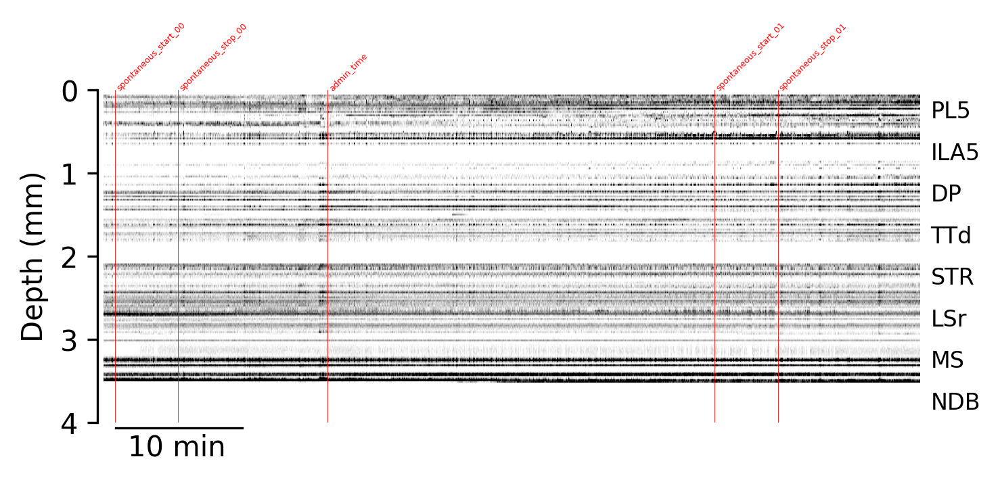

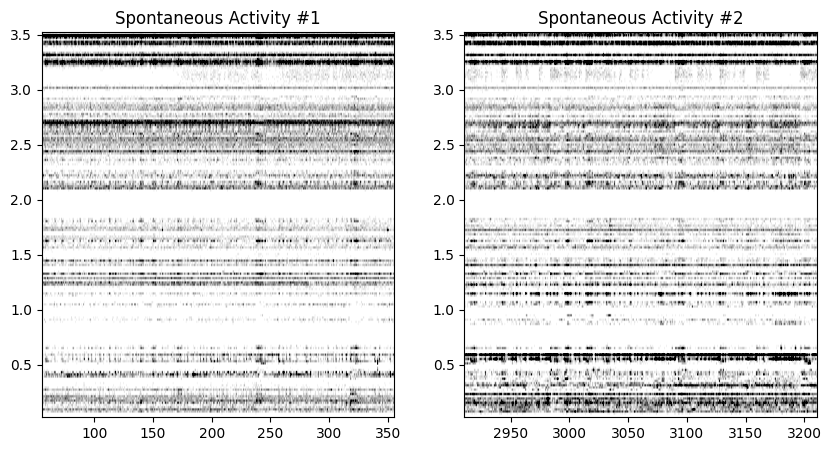

<Figure size 1600x800 with 0 Axes>

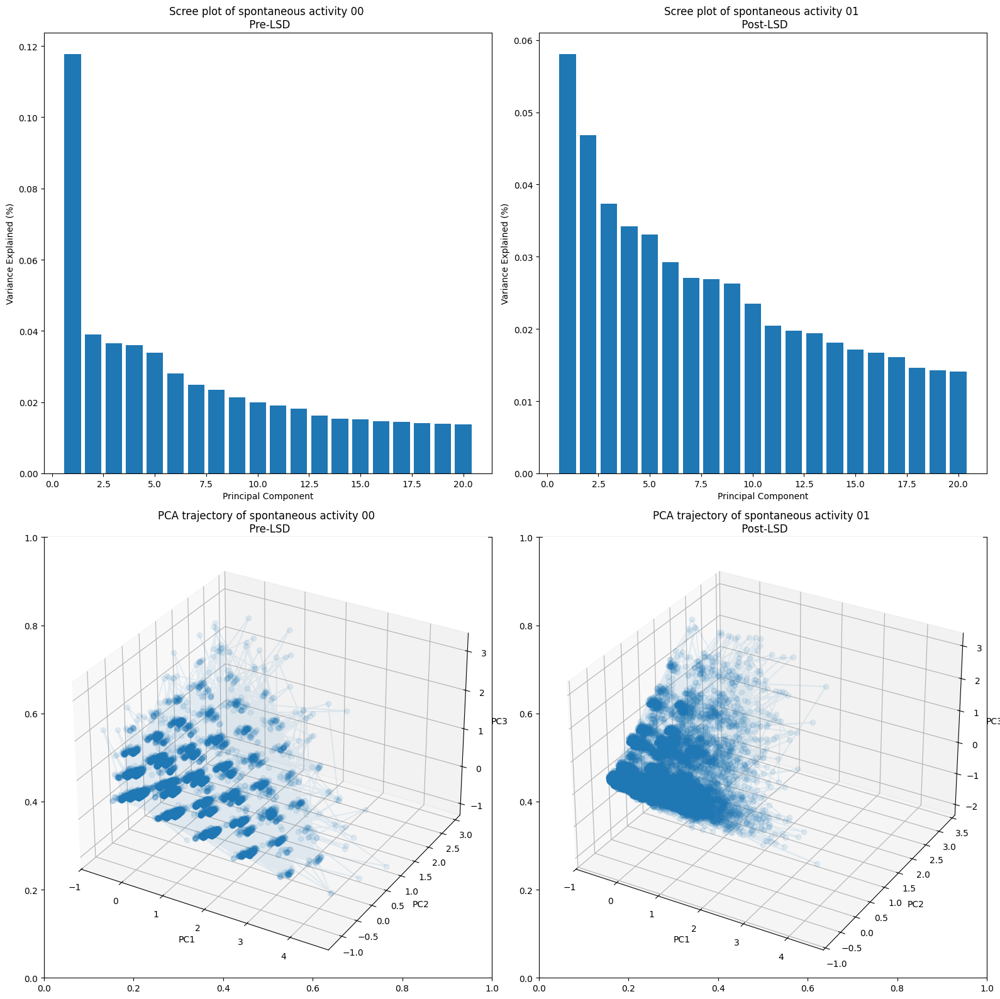

9523391b-d87d-47e4-9f60-ee1abc431202
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_bodyCamera.times.npy',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_leftCamera.features.pqt',
 'alf/_ibl_leftCamera.times.npy',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/_ibl_rightCamera.features.pqt',
 'alf/_ibl_rightCamera.times.npy',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/licks.times.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykiloso

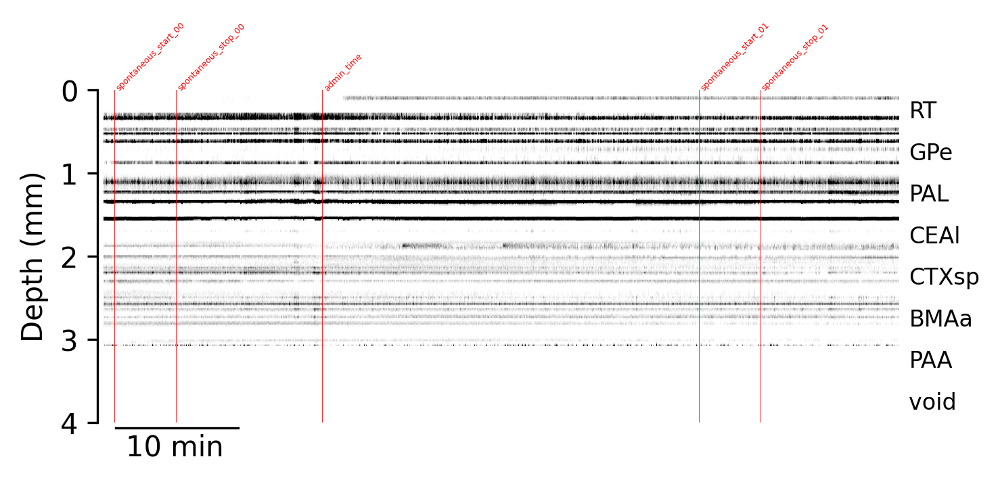

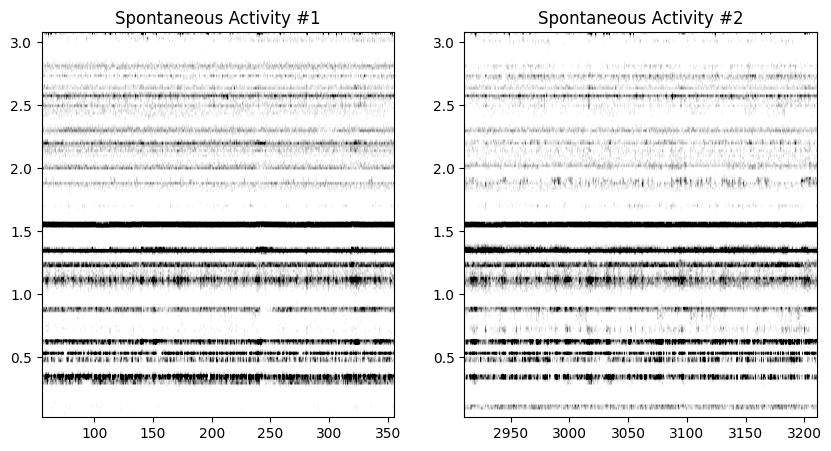

<Figure size 1600x800 with 0 Axes>

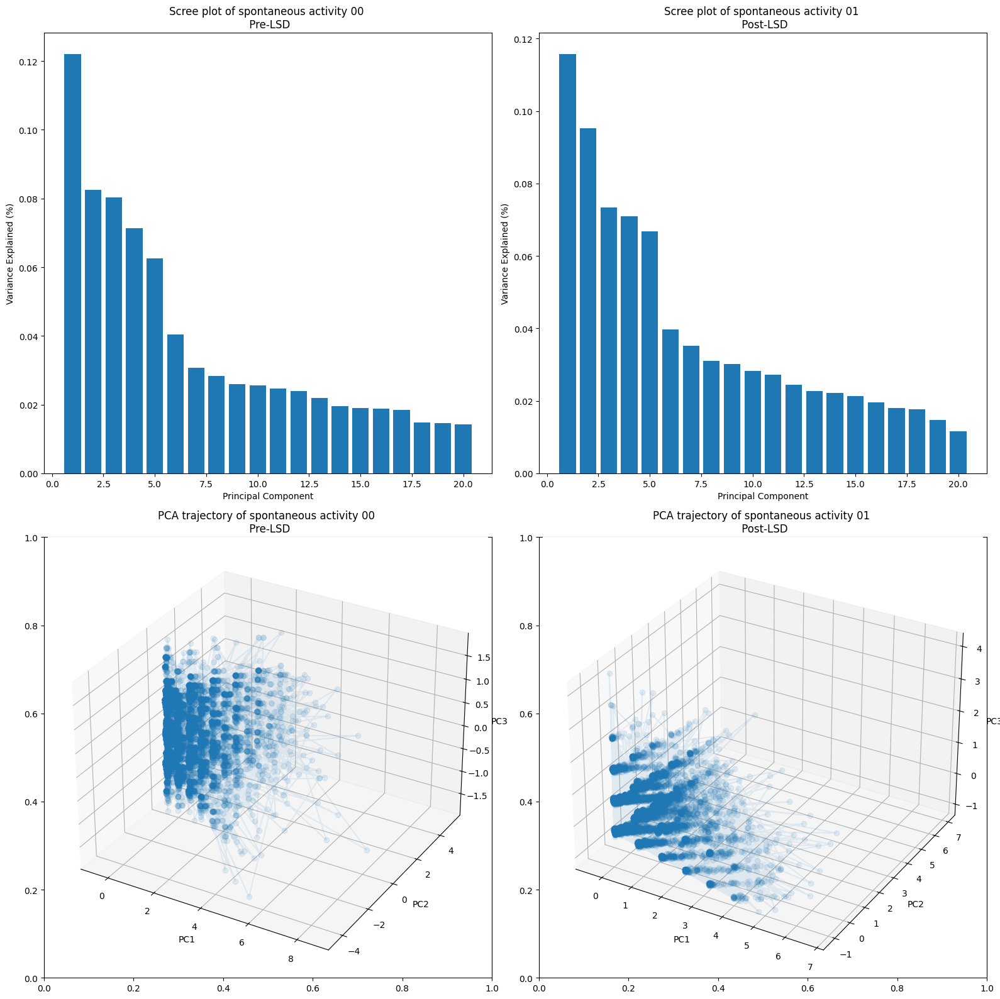

0143de04-dffb-4032-af5f-25f2b3f5551d
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/probe00/pykilosort/clusters.amps.npy',
 'alf/probe00/pykilosort/clusters.channels.npy',
 'alf/probe00/pykilosort/clusters.depths.npy',
 'alf/probe00/pykilosort/clusters.metrics.pqt',
 'alf/probe00/pykilosort/clusters.peakToTrough.npy',
 'alf/probe00/pykilosort/clusters

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05725/2023-01-31/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 211/211 [00:00<00:00, 415B/s]


Unexpected error Dataset "alf/task_01/_ibl_passivePeriods.intervalsTable.csv" not found 
 The ALF object was not found.  This may occur if the object or namespace or incorrectly formatted e.g. the object "_ibl_trials.intervals.npy" would be found with the filters `object="trials", namespace="ibl"`  occurred for PID: 0143de04-dffb-4032-af5f-25f2b3f5551d. Continuing to next PID.
1a137e13-99e3-4d75-b421-27779d2c15c1
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05486/2022-12-15/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 207/207 [00:00<00:00, 500B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05486/2022-12-15/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 210/210 [00:00<00:00, 520B/s]


{'spontaneous_start_00': 67.26315318465646, 'spontaneous_stop_00': 367.2950866457781, 'admin_time': 1173, 'spontaneous_start_01': 3092.009015017681, 'spontaneous_stop_01': 3392.074611778803}


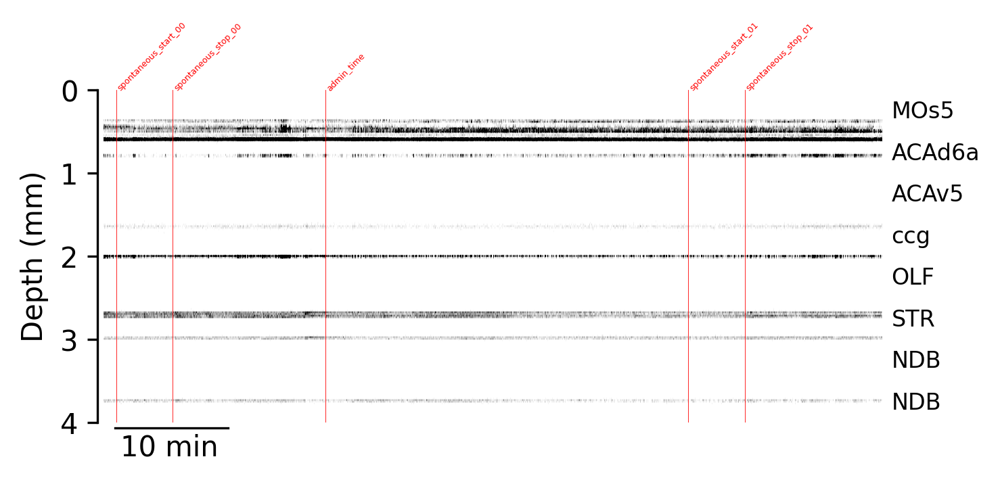

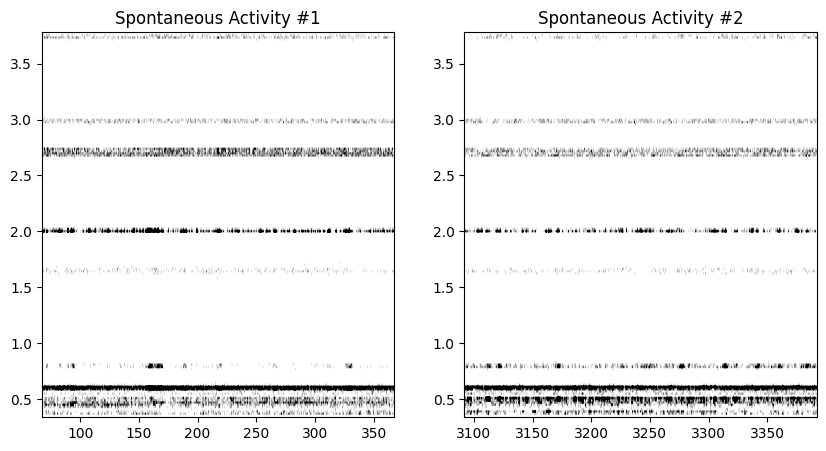

<Figure size 1600x800 with 0 Axes>

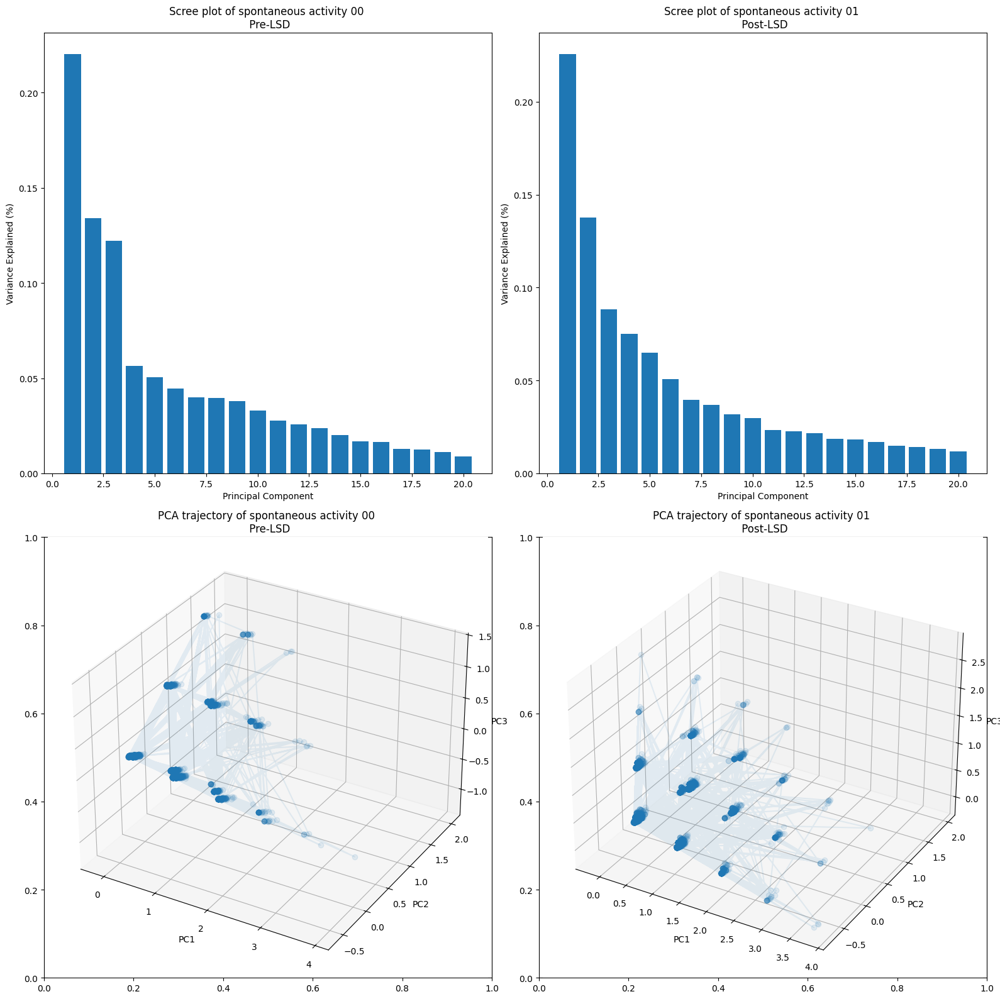

387de168-4a60-48d7-be77-9ddce5a4a757
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.mlapdv.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/p

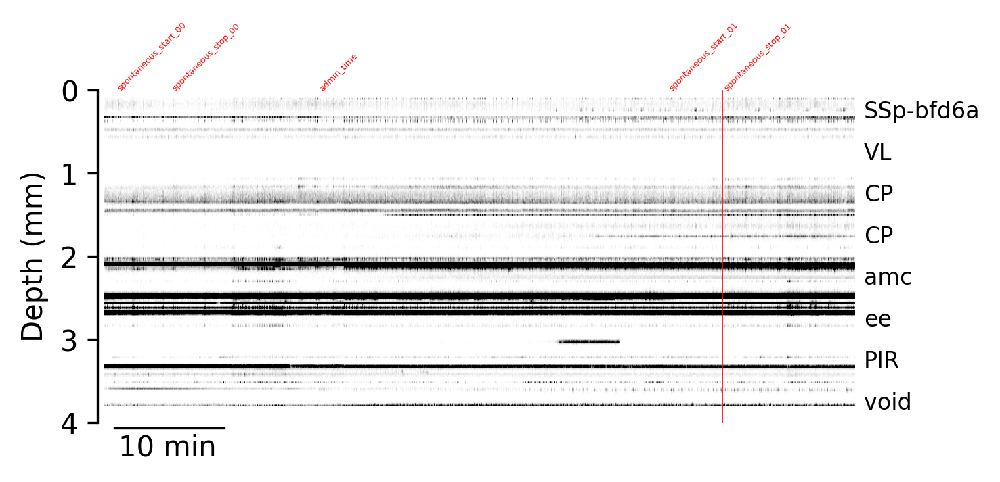

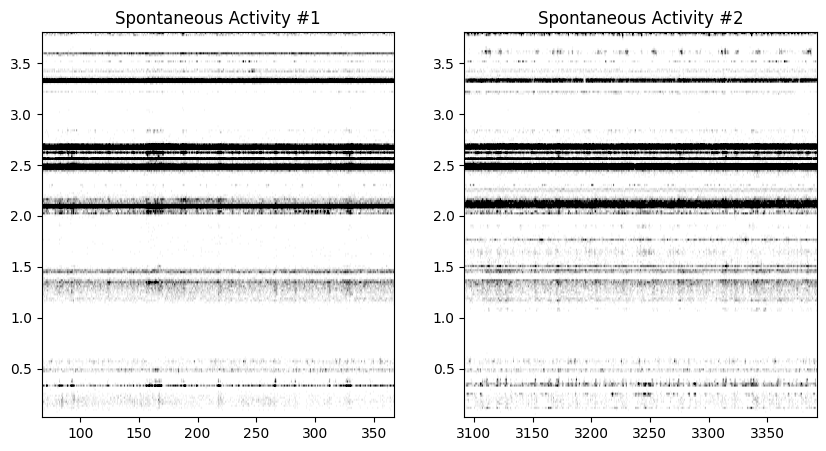

<Figure size 1600x800 with 0 Axes>

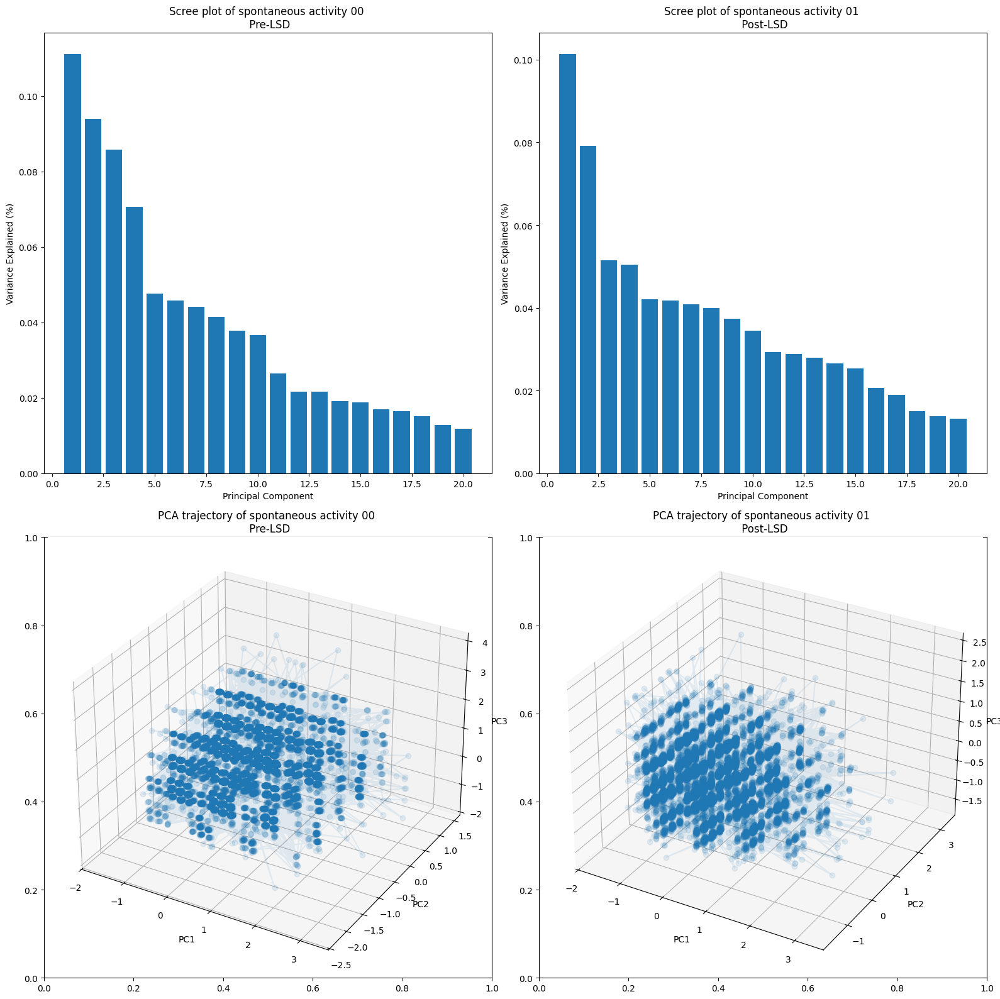

8eb4026a-7b2e-4bb7-9939-9b17202052d4
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.mlapdv.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/p

(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05496/2022-12-15/001/alf/task_00/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 208/208 [00:00<00:00, 674B/s]
(S3) /home/openlab/Downloads/ONE/alyx.internationalbrainlab.org/mainenlab/Subjects/ZFM-05496/2022-12-15/001/alf/task_01/_ibl_passivePeriods.intervalsTable.csv: 100%|██████████| 210/210 [00:00<00:00, 521B/s]


{'spontaneous_start_00': 62.81849769465202, 'spontaneous_stop_00': 362.8675627757737, 'admin_time': 1100, 'spontaneous_start_01': 3399.2493879079884, 'spontaneous_stop_01': 3699.31488467911}


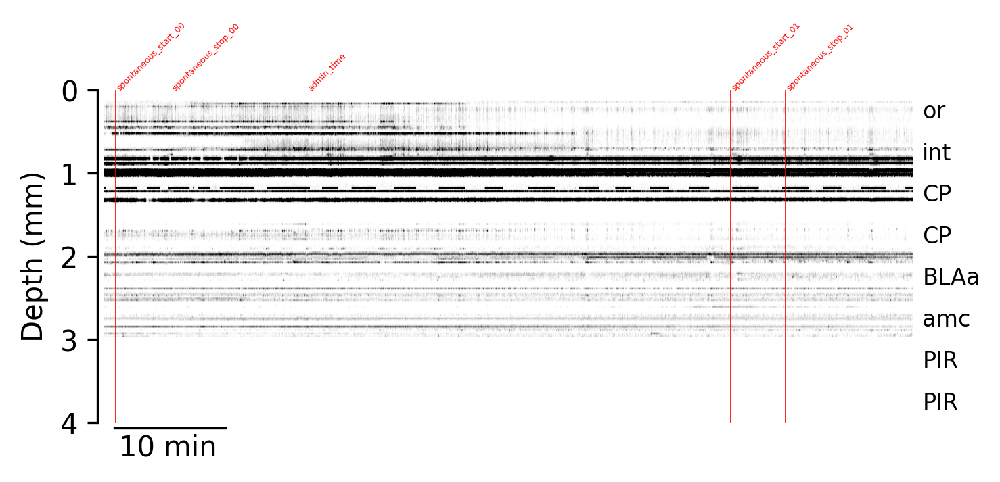

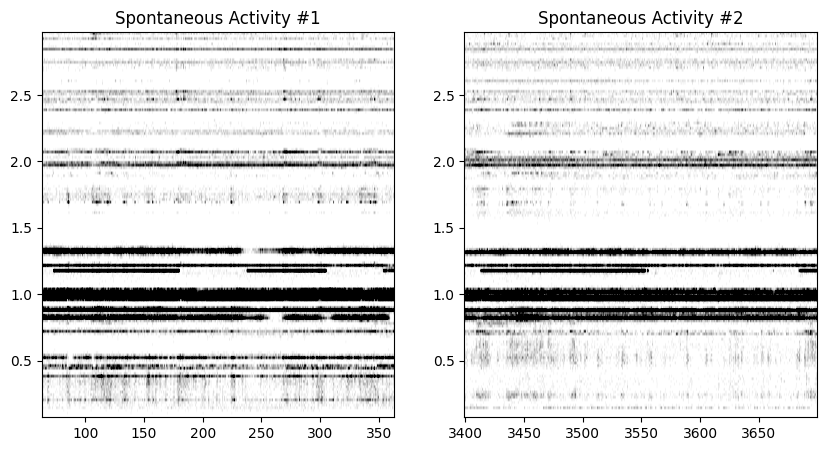

<Figure size 1600x800 with 0 Axes>

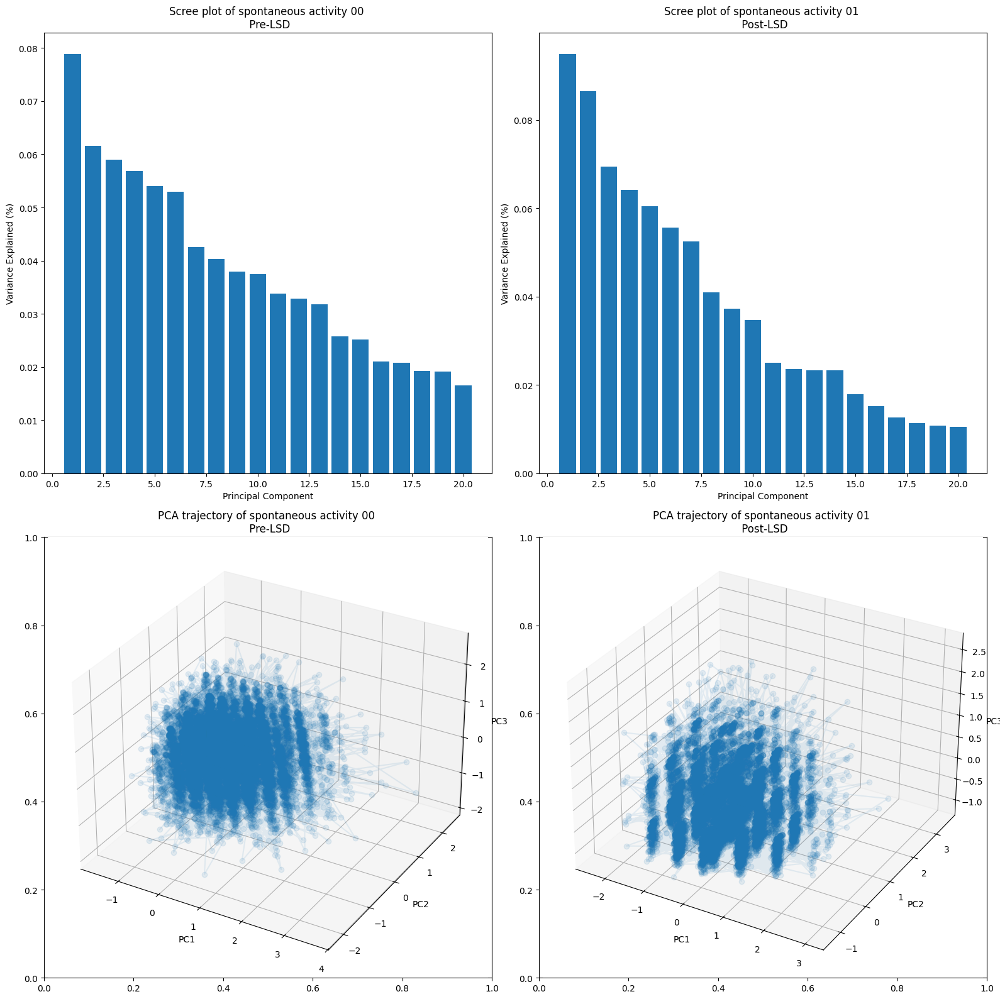

dc0b7750-372a-45a5-a590-1adf1491f98b
['_ibl_experiment.description.yaml',
 'alf/_ibl_bodyCamera.dlc.pqt',
 'alf/_ibl_leftCamera.dlc.pqt',
 'alf/_ibl_rightCamera.dlc.pqt',
 'alf/bodyCamera.ROIMotionEnergy.npy',
 'alf/bodyROIMotionEnergy.position.npy',
 'alf/leftCamera.ROIMotionEnergy.npy',
 'alf/leftROIMotionEnergy.position.npy',
 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy',
 'alf/probe00/electrodeSites.localCoordinates.npy',
 'alf/probe00/electrodeSites.mlapdv.npy',
 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log',
 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.channels.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy',
 'alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy',
 'alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy',
 'alf/probe00/pykilosort/channels.localCoordinates.npy',
 'alf/probe00/pykilosort/channels.mlapdv.npy',
 'alf/probe00/pykilosort/channels.rawInd.npy',
 'alf/p

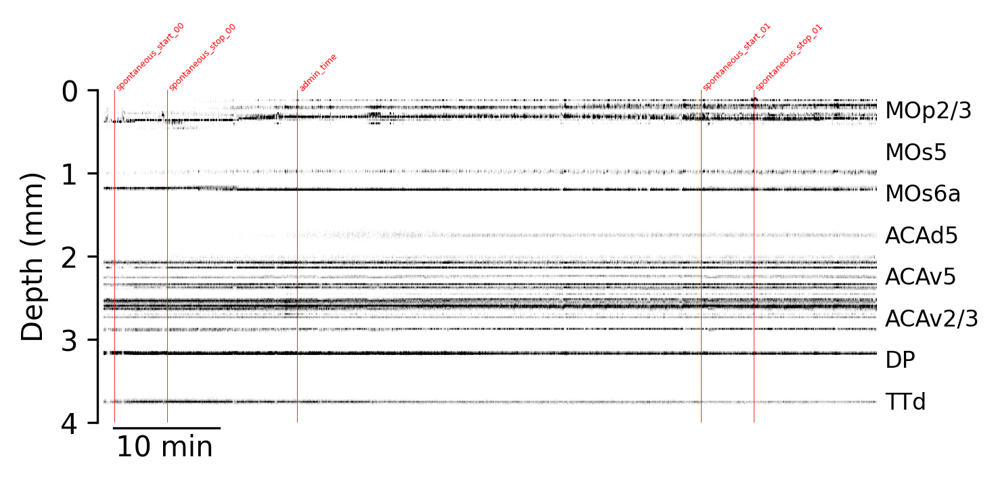

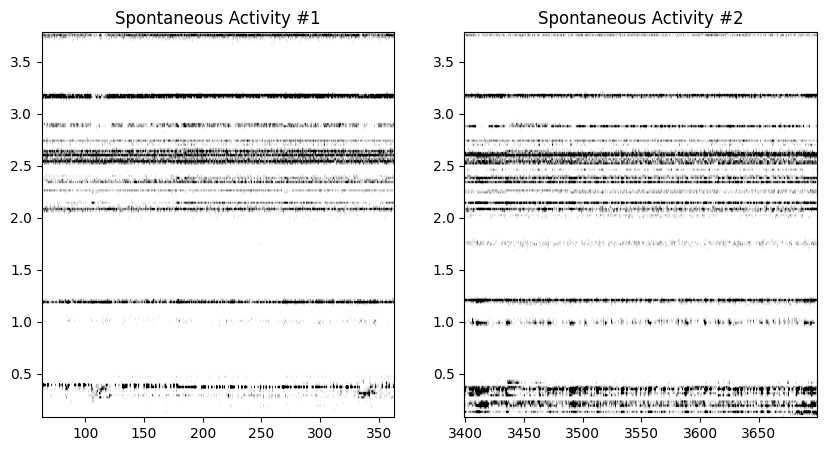

<Figure size 1600x800 with 0 Axes>

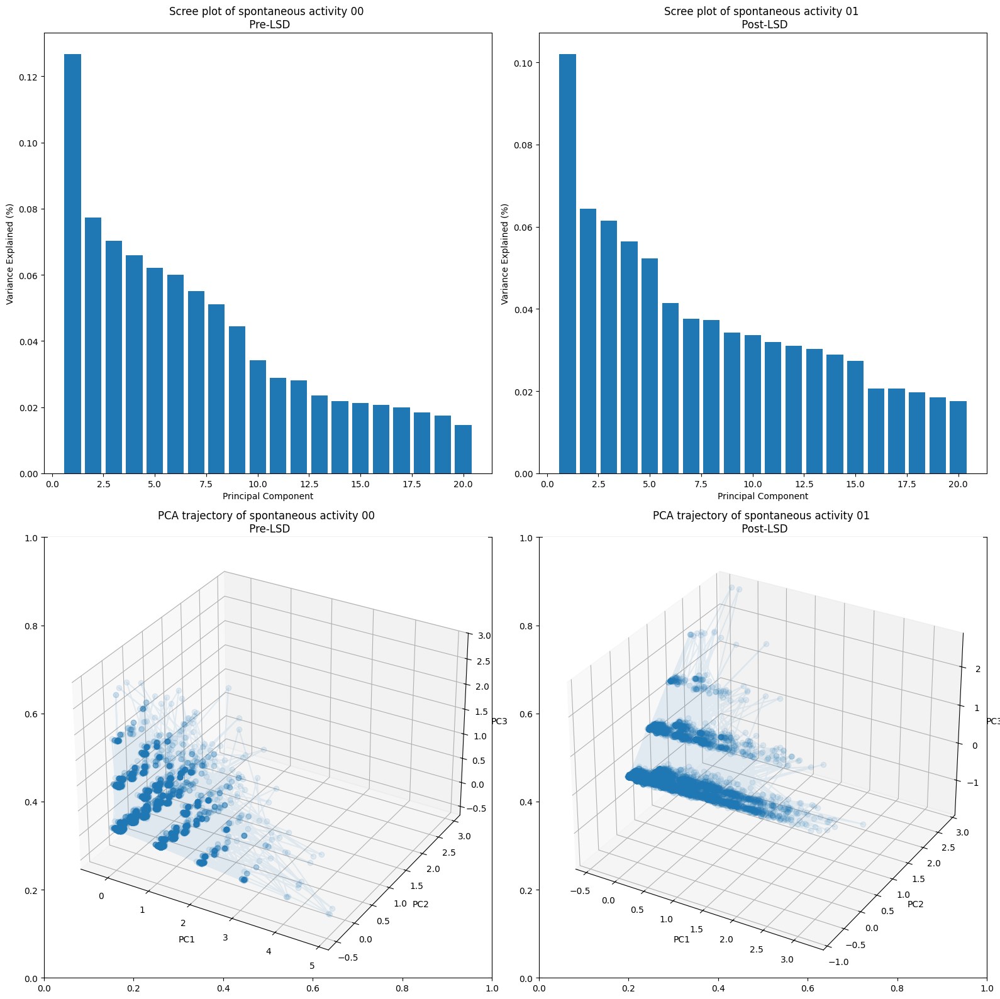

5e941562-6a56-407d-b3a3-c455acf36c12
Unexpected error  occurred for PID: 5e941562-6a56-407d-b3a3-c455acf36c12. Continuing to next PID.
d46ba0cb-fd0c-4322-86fd-07fd690729a0
Unexpected error  occurred for PID: d46ba0cb-fd0c-4322-86fd-07fd690729a0. Continuing to next PID.
a359c636-17de-4151-8dc7-9fc78d0db374
Unexpected error  occurred for PID: a359c636-17de-4151-8dc7-9fc78d0db374. Continuing to next PID.


In [16]:
for pid in pids_spikes:
    try:
        run_PCA(pid)
    # except ALFObjectNotFound:
    #     print(f'ALFObjectNotFound Error for PID: {pid}, moving on to next PID')
    except Exception as e:
        print(f'Unexpected error {e} occurred for PID: {pid}. Continuing to next PID.')

In [86]:
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.colors as mcolors
from matplotlib.collections import LineCollection
import numpy as np


# Perform PCA to get the 1st 3 components
pca = PCA(n_components=3)
pca_result = pca.fit_transform(spontaneous_activity_00.T)

# Generate colors
cNorm  = mcolors.Normalize(vmin=0, vmax=spontaneous_activity_00.shape[1]-1)
scalarMap = plt.cm.ScalarMappable(norm=cNorm, cmap=plt.cm.jet)

# Make matplotlib's LineCollection
lines = [np.column_stack([pca_result[i,:], pca_result[i+1,:]]).T for i in range(pca_result.shape[0]-1)]
lc = LineCollection(lines, linewidths=1, alpha=0.5, norm=cNorm, cmap=plt.cm.jet)

# Plot each point 
fig = plt.figure(figsize = (8,8))
ax = plt.axes(projection = '3d')
ax.add_collection(lc)

ax.set_xlim(pca_result[:,0].min(),pca_result[:,0].max())
ax.set_ylim(pca_result[:,1].min(),pca_result[:,1].max())
ax.set_zlim(pca_result[:,2].min(),pca_result[:,2].max())

# Set PCA projections as coordinates to color according to the time
lc.set_array(np.arange(spontaneous_activity_00.shape[1]-1))

plt.show()

ValueError: 'vertices' must be 2D with shape (N, 2), but your input has shape (2, 3)

KeyboardInterrupt: 

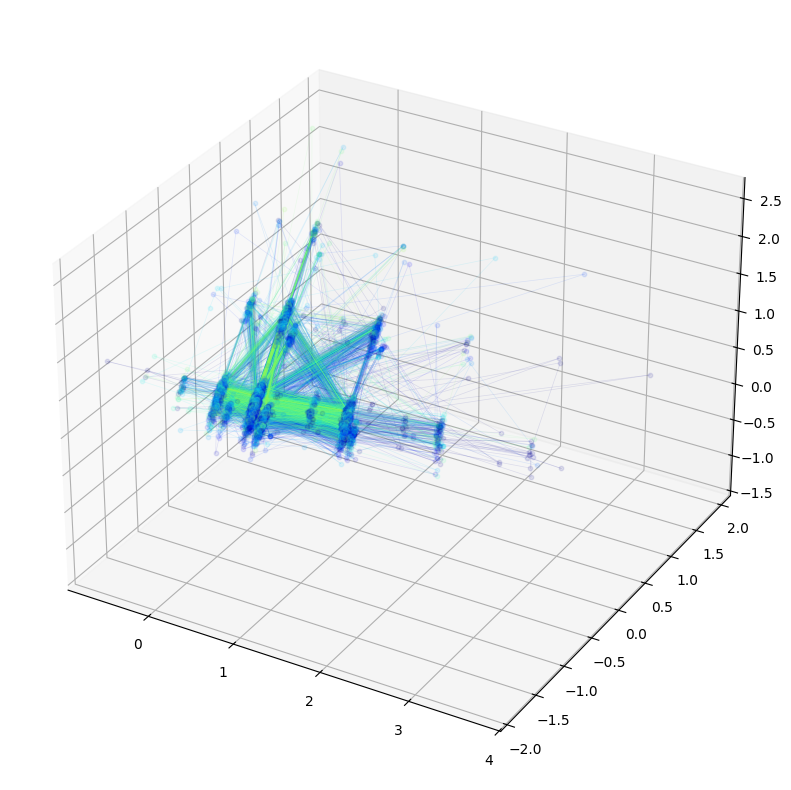

In [88]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

# Perform PCA to get the 1st 3 components
pca = PCA(n_components=3)
pca_result = pca.fit_transform(spontaneous_activity_00.T)

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')

# Time as color map
colors = plt.cm.jet(np.linspace(0,1,pca_result.shape[0]))

# Plot each point. Color maps time
for i in range(pca_result.shape[0]):
    ax.plot(pca_result[i:i+2,0],
            pca_result[i:i+2,1],
            pca_result[i:i+2,2],
            color=colors[i],
            alpha=0.1,     # Transparency
            lw=0.5)        # Line width
    ax.scatter(pca_result[i,0],
               pca_result[i,1],
               pca_result[i,2],
               color=colors[i],
               alpha=0.1,
               s=10)         # Size 

ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
plt.show()